<a href="https://colab.research.google.com/github/Akramovic1/Image_Segmentation/blob/main/Image_Segmentation.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Download the Dataset and Understand the Format

In [ ]:
!wget -q {"http://www.eecs.berkeley.edu/Research/Projects/CS/vision/grouping/BSR/BSR_bsds500.tgz"}
!tar -xzf /content/BSR_bsds500.tgz

In [ ]:
import numpy as np
import scipy.io
import glob
from PIL import Image
from scipy import io
import pandas as pd
import os
import matplotlib.pyplot as plt
from scipy.spatial import distance

In [ ]:
#Get the images for training
train = sorted(glob.glob("BSR/BSDS500/data/images/train/**/*.jpg", recursive=True))

#Get the images for testing
test = sorted(glob.glob("BSR/BSDS500/data/images/test/**/*.jpg", recursive=True))
test = test[0:50]

#Get the ground-truth for training
gt_train = sorted(glob.glob("BSR/BSDS500/data/groundTruth/train/**/*.mat", recursive=True))

#Get the ground-truth for testing
gt_test = sorted(glob.glob("BSR/BSDS500/data/groundTruth/test/**/*.mat", recursive=True))
gt_test = gt_test[0:50]

##Visualize the image and the ground truth segmentation

In [ ]:
def VisualizeImageGroundTruth(filename):
  file = "/content/BSR/BSDS500/data/images/train/" +(filename)+'.jpg'
  pil_im = Image.open(file) 
  im_array = np.asarray(pil_im)
  print("Original Image")
  plt.imshow(im_array)
  plt.show()
  mat = io.loadmat('/content/BSR/BSDS500/data/groundTruth/train/'+(filename) + '.mat')
  fig = plt.figure(figsize=(15, 20))
  print("Ground Truth")
  for i in range((mat['groundTruth'].shape[1] - 1)):
    seg = np.array(mat['groundTruth'][0, i][0, 0][0])
    bud = np.array(mat['groundTruth'][0, i][0, 0][1])
    fig.add_subplot((mat['groundTruth'].shape[1]), 2, (i * 2 + 1))
    plt.axis('off')
    plt.imshow(seg)
    fig.add_subplot((mat['groundTruth'].shape[1]), 2, (i * 2 + 1) + 1)
    plt.axis('off')
    plt.imshow(bud)
  plt.show()
  return im_array,mat

Original Image


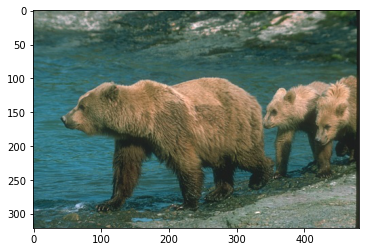

Ground Truth


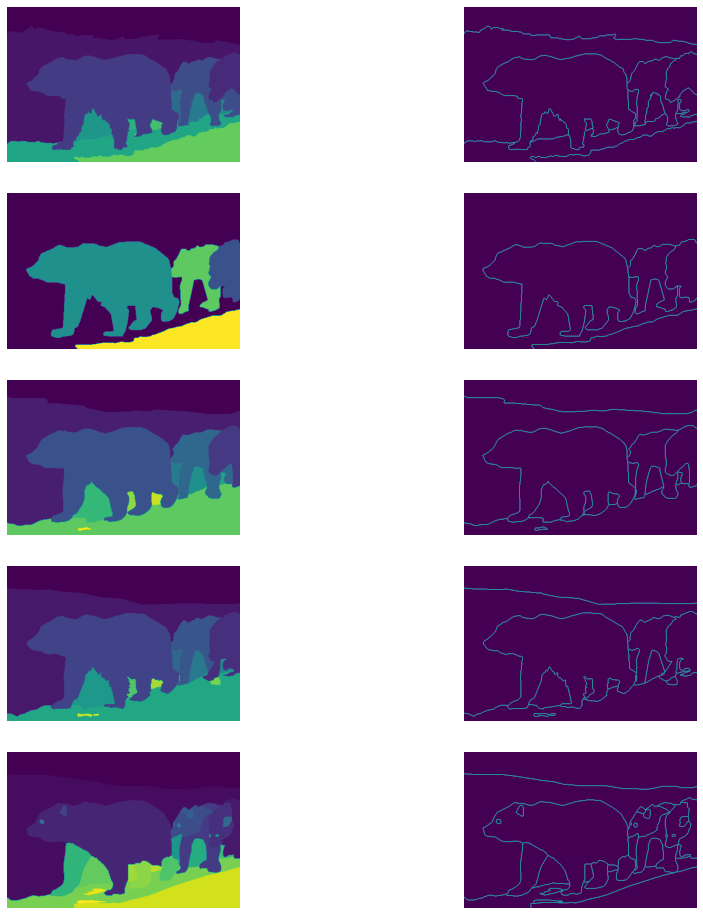

Original Image


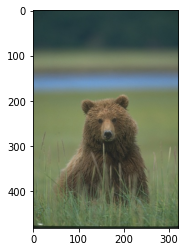

Ground Truth


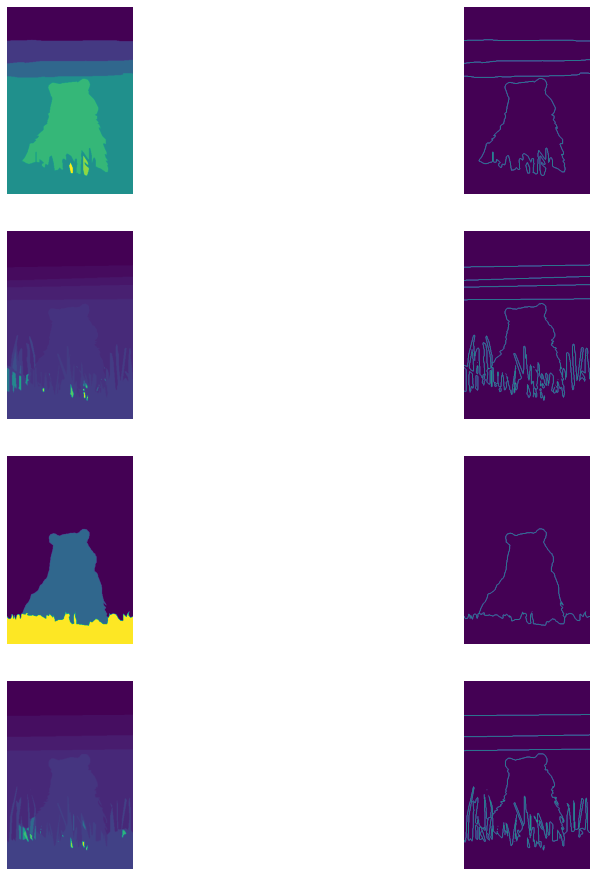

Original Image


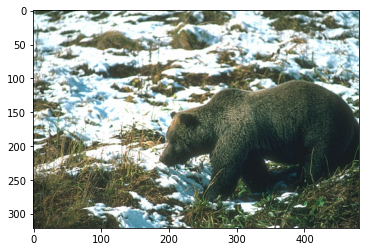

Ground Truth


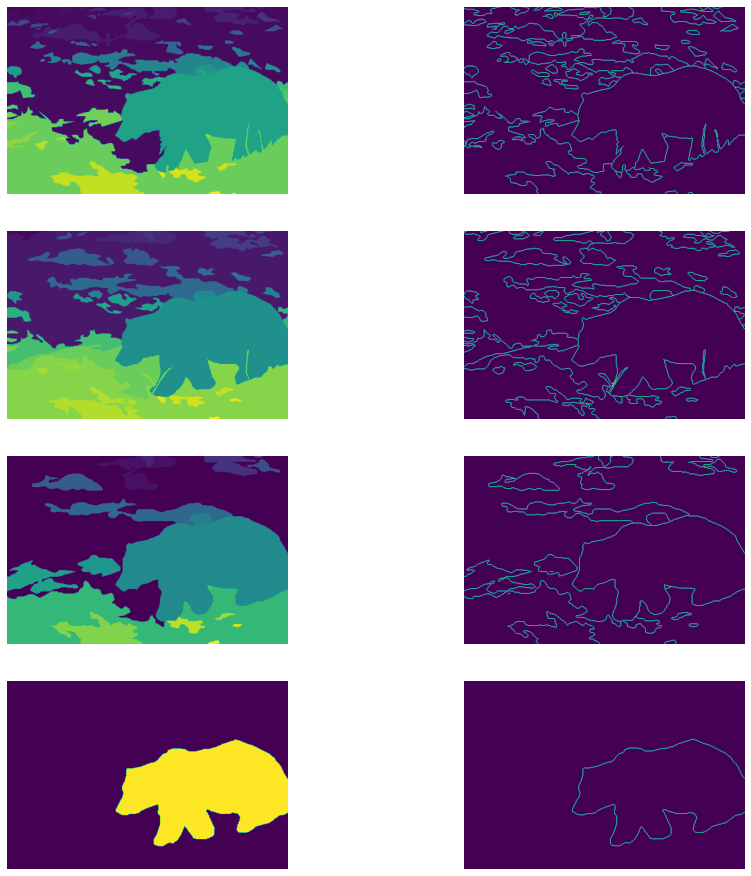

Original Image


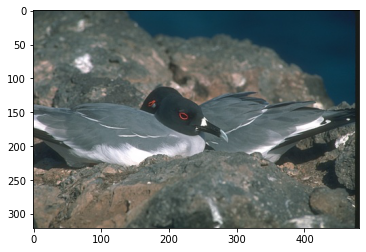

Ground Truth


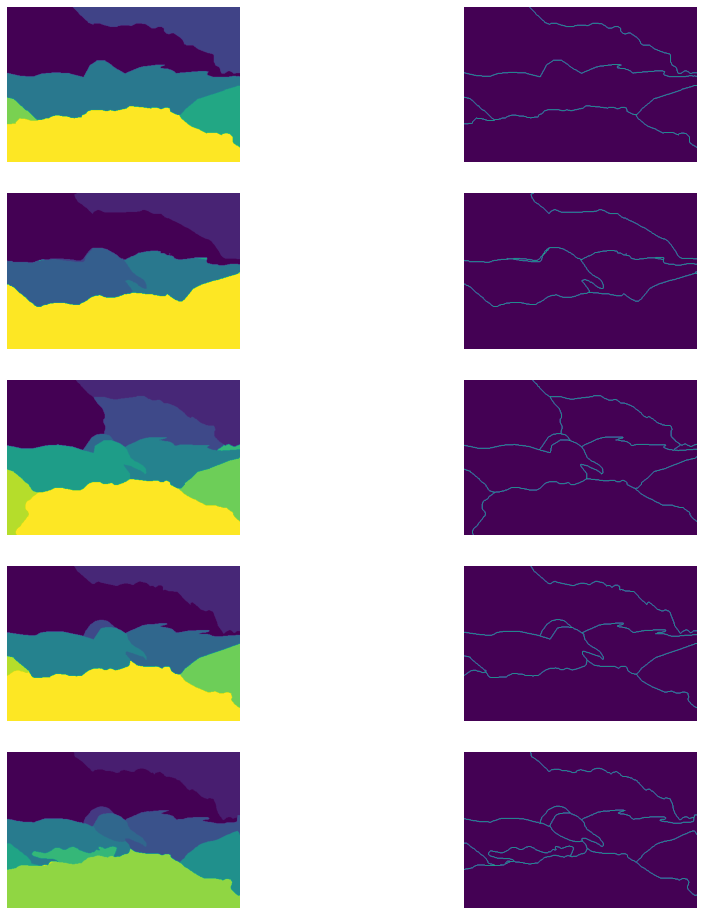

Original Image


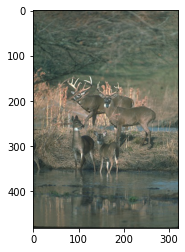

Ground Truth


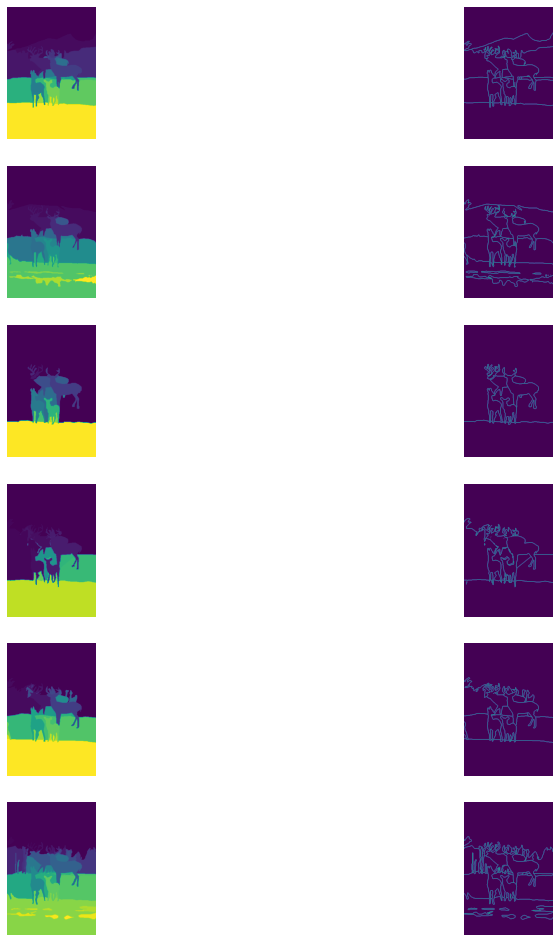

Original Image


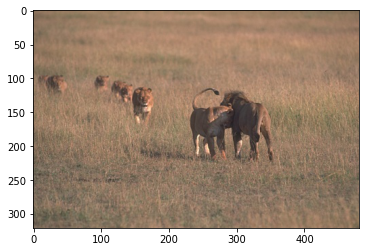

Ground Truth


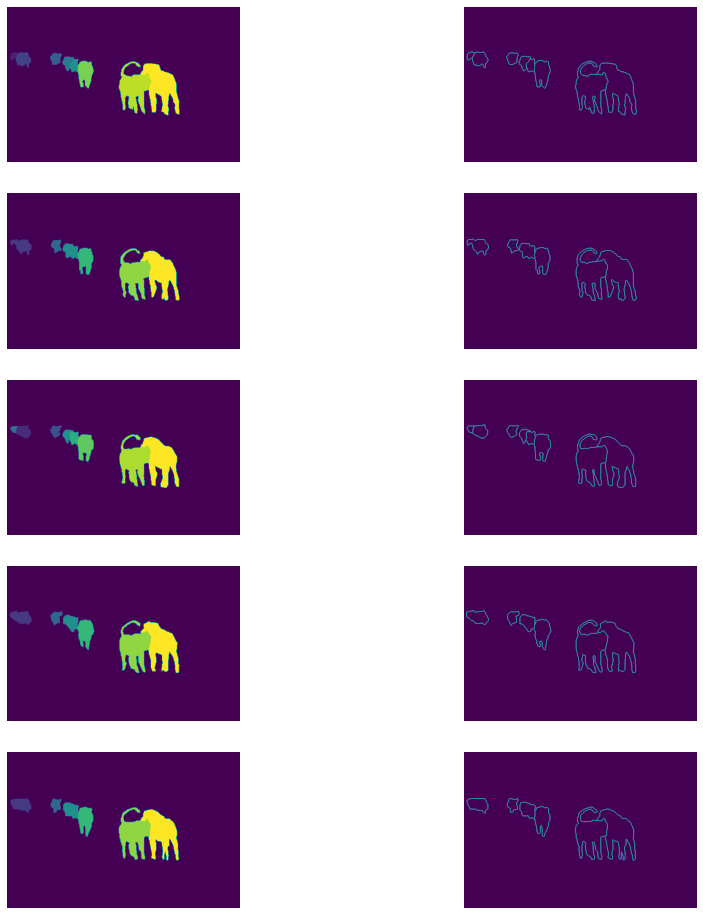

Original Image


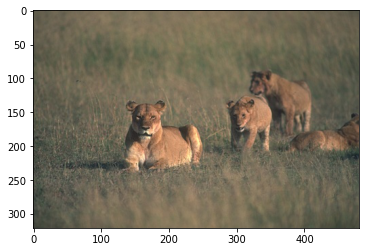

Ground Truth


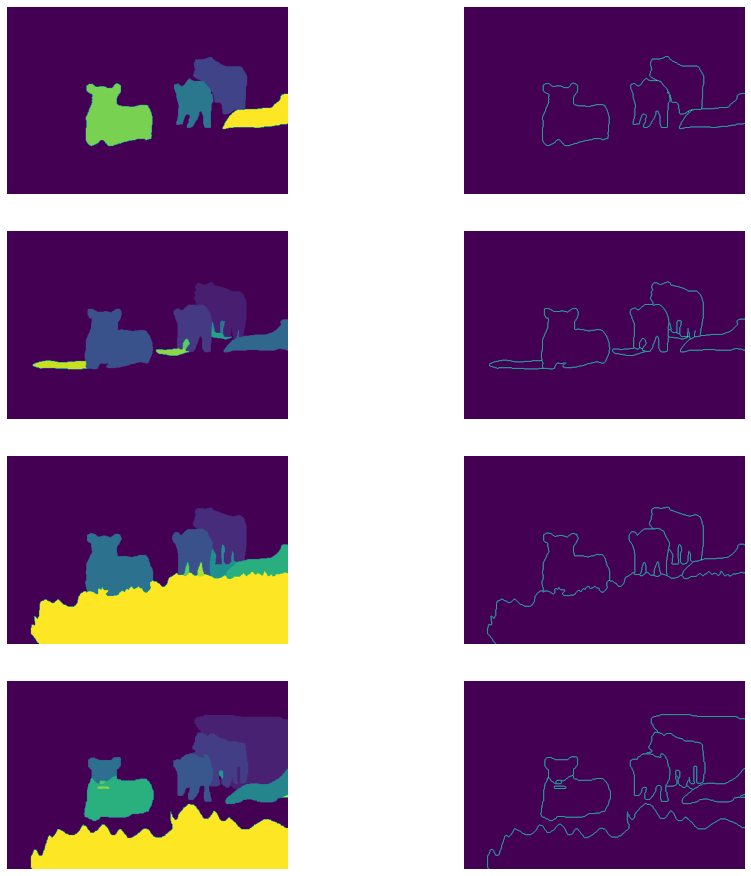

Original Image


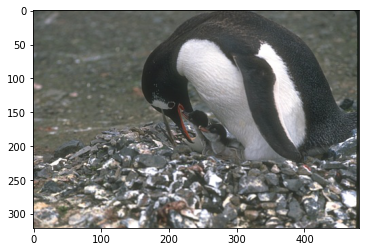

Ground Truth


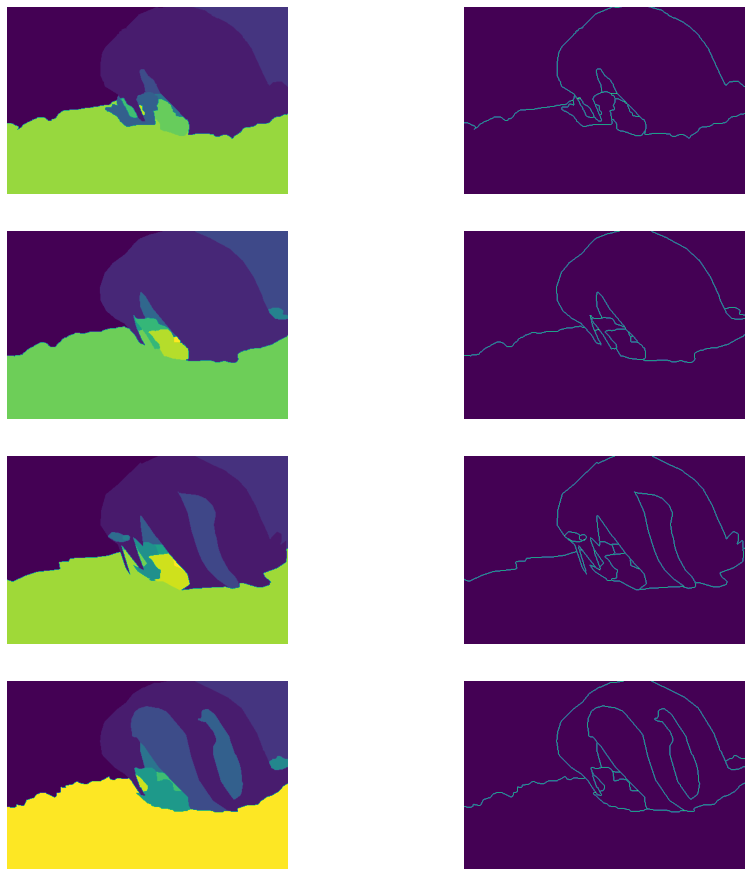

Original Image


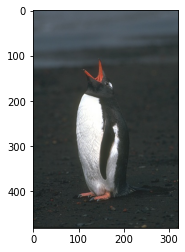

Ground Truth


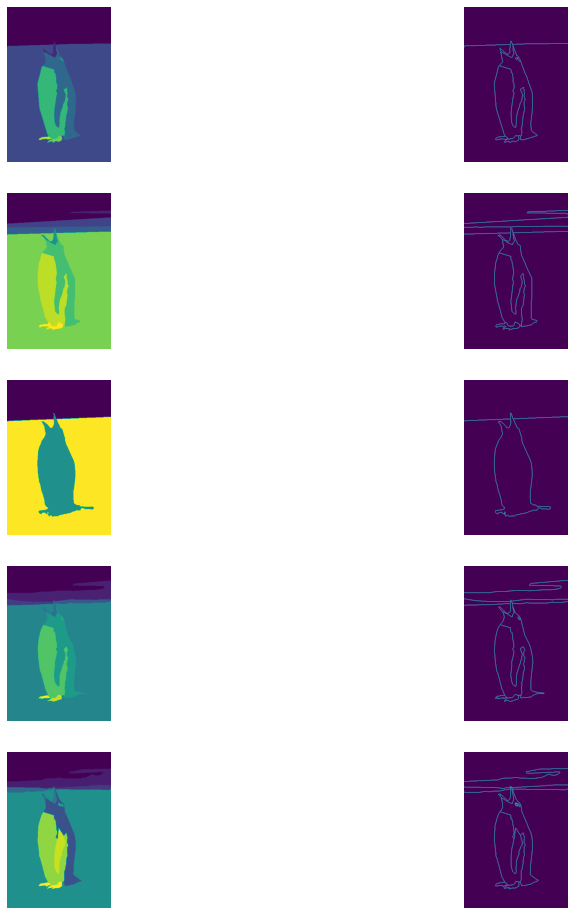

Original Image


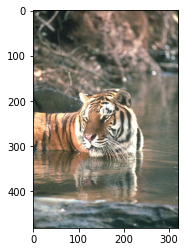

Ground Truth


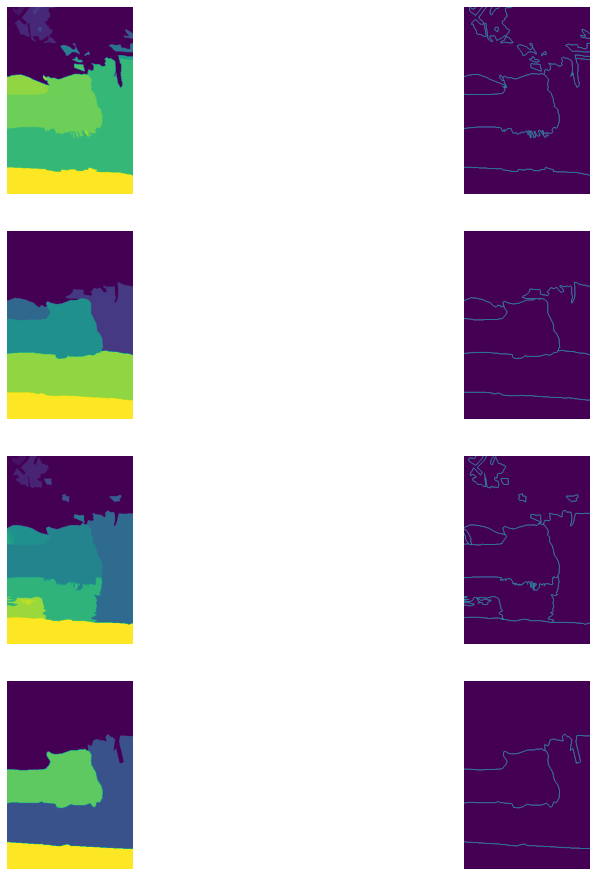

In [ ]:
for image in train[0:10]:
  filename = os.path.splitext(os.path.basename(image))[0]
  VisualizeImageGroundTruth(filename)

## Kmeans

In [ ]:
def kmeans(X,k,max_iterations=100):
    if isinstance(X, pd.DataFrame):X = X.values
    idx = np.random.choice(len(X), k, replace=False)
    centroids = X[idx, :]
    P = np.argmin(distance.cdist(X, centroids, 'euclidean'),axis=1)
    for _ in range(max_iterations):
        centroids = np.vstack([X[P==i,:].mean(axis=0) for i in range(k)])
        tmp = np.argmin(distance.cdist(X, centroids, 'euclidean'),axis=1)
        if np.array_equal(P,tmp):break
        P = tmp
    return P

In [ ]:
def getSegmentedKMeans(img_array,Ks):
  h = len(img_array)
  w = len(img_array[0])
  img_array = img_array.reshape(154401,3)

  segmented_results = np.empty([len(Ks),h,w])
  for k,i in zip((Ks),range(len(Ks))):
    seg = kmeans(img_array,k)

    segmented_results[i] = np.array(seg).reshape(h,w)
    ## print(segmented_results[i])
    # plt.imshow(segmented_results[i])
    # plt.show()
  return (segmented_results)

def ShowSegmentedKMeans(segmented_results):
  for i in range(len(segmented_results)):
    plt.imshow(segmented_results[i])
    plt.show()

Original Image


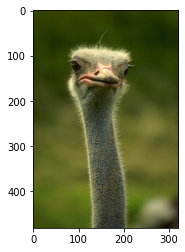

KMeans Results


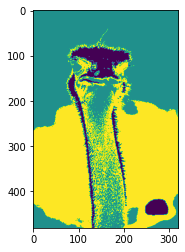

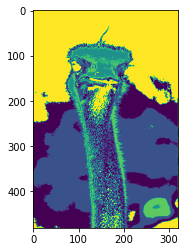

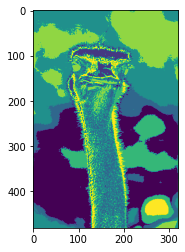

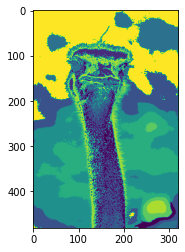

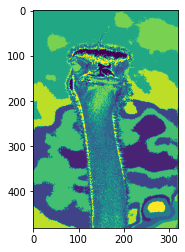

In [ ]:
# filename = glob.glob("BSR/BSDS500/data/images/train/239096.jpg")
# test_image=Image.open(filename[0])
file = "/content/BSR/BSDS500/data/images/train/66075.jpg"
pil_im = Image.open(file) 
im_array = np.asarray(pil_im)
print("Original Image")
plt.imshow(im_array)
plt.show()

segmented_results = getSegmentedKMeans(im_array,np.array([3,5,7,9,11]))
print("KMeans Results")
ShowSegmentedKMeans(segmented_results)


---------------------------------------------

In [ ]:
mat = io.loadmat('/content/BSR/BSDS500/data/groundTruth/train/66075.mat')

In [ ]:
from sklearn.metrics.cluster import contingency_matrix
def getFMeasure(segmented_results,mat,kValue = np.array([3,5,7,9,11])):
  # kValue = np.array([3,5,7,9,11])
  for i in range(len(segmented_results)):
    print("-----------------------------------------------------")
    pred = segmented_results[i].flatten()
    f1_score_list = []
    for j in range(mat['groundTruth'].shape[1]):
      truth = mat['groundTruth'][0, j][0, 0][0].flatten()
      # print(len(pred))
      # print(len(truth))
      con = contingency_matrix(truth, pred, eps=None, sparse=False).T
      prec = 0.0
      recall = 0.0
      f1_score = 0.0
      for k in range(len(con)):
        idx = np.argmax(con[k])
        prec = con[k][idx] * 1.0 / sum(con[k])
        recall = con[k][idx] * 1.0 / sum(con[:,idx])
        f1_score += (2.0 * prec * recall / (prec + recall))
      f1_score /= len(con) * 1.0
      f1_score_list.append(f1_score)
      print("Ground Truth [",j,"] Segment [",i,"]: F-measure = ",np.around(f1_score,decimals=2))
    print("@ k = %2d Average F-measure of 5 ground Truth = %5.2f"% (kValue[i],sum(f1_score_list)/mat['groundTruth'].shape[1]))
  # return np.array(f1_score_list)

In [ ]:
getFMeasure(segmented_results,mat)

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.53
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.52
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.54
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.52
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.52
@ k =  3 Average F-measure of 5 ground Truth =  0.53
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.38
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.38
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.42
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.38
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.38
@ k =  5 Average F-measure of 5 ground Truth =  0.39
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.32
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.32
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.42
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.31
Grou

In [ ]:
import math
def getConditionalEntropy(segmented_results,mat, kValue = np.array([3,5,7,9,11])):
  cond_entropy_list = []
  for m in range(len(segmented_results)):
    pred = segmented_results[m].flatten()
    for n in range(mat['groundTruth'].shape[1]):
      truth = mat['groundTruth'][0, n][0, 0][0].flatten()
      predicted_labels = np.unique(pred)
      predicted_indicies = np.array([ np.where(pred == i) for i in predicted_labels if np.where(pred == i)[0].size > 0])
      clusters = [0 for x in predicted_labels]
      for i in range(len(predicted_labels)):
        clusters[i] = np.array([truth[j] for j in predicted_indicies[i]])
      cond_entropy_ = np.zeros(len(clusters))
      for i,c in zip(clusters,range(len(clusters))):
        sum_ = np.array([(np.array(i) == j).sum() for j in np.unique(truth)])
        entropy_ = np.array([j / (1.0 * len(i[0])) for j in sum_])
        entropy_ = np.array([math.log(j) * (j) * -1.0 for j in entropy_ if j != 0])
        cond_entropy_[c] = sum(entropy_) * len(i[0]) * 1.0 / len(pred)
      cond_entropy_list.append(sum(cond_entropy_))
      print("Conditional Entropy:",sum(cond_entropy_))
    print("-----------------------------------------------------")
    print("@ k = %2d Average Conditional Entropy of 5 ground Truth = %5.2f"% (kValue[m],sum(cond_entropy_list)/mat['groundTruth'].shape[1]))
    print("-----------------------------------------------------")

In [ ]:
getConditionalEntropy(segmented_results,mat)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:9: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  if __name__ == '__main__':


Conditional Entropy: 0.6112780723830038
Conditional Entropy: 0.5792388519077696
Conditional Entropy: 1.1817608376127349
Conditional Entropy: 0.5849991265336602
Conditional Entropy: 0.7232249418191843
-----------------------------------------------------
@ k =  3 Average Conditional Entropy of 5 ground Truth =  0.74
-----------------------------------------------------
Conditional Entropy: 0.5622449954250388
Conditional Entropy: 0.540903138333387
Conditional Entropy: 1.0998811752557627
Conditional Entropy: 0.5460338533176297
Conditional Entropy: 0.6759241853745034
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  1.42
-----------------------------------------------------
Conditional Entropy: 0.4920278371835381
Conditional Entropy: 0.4681148755291696
Conditional Entropy: 0.9927303221708973
Conditional Entropy: 0.4723567847942728
Conditional Entropy: 0.5983308044814823
-----------------------------------------------------
@ k =

In [ ]:
def KMeans50():
  for i in test:
    file = "/content/"+str(i)
    pil_im = Image.open(file) 
    im_array = np.asarray(pil_im)
    print("Original Image")
    plt.imshow(im_array)
    plt.show()

    segmented_results = getSegmentedKMeans(im_array,np.array([3,5,7,9,11]))
    print("KMeans Results")
    ShowSegmentedKMeans(segmented_results)
    
    filename = os.path.splitext(os.path.basename(i))[0]
    mat = io.loadmat('/content/BSR/BSDS500/data/groundTruth/test/'+filename+'.mat')
    
    getFMeasure(segmented_results,mat)
    getConditionalEntropy(segmented_results,mat)


##Big Picture

In [ ]:
def groundTruthAgainstSegResults(images):
  for imgName in images:
    im_array,mat = VisualizeImageGroundTruth(str(imgName))
    segmented_resultsKMeans = getSegmentedKMeans(im_array,np.array([5])) # k = 5
    print("*************** Segmentation result at K = 5 | Using KMeas***************")
    ShowSegmentedKMeans(segmented_resultsKMeans)
    # print(len(segmented_resultsKMeans[0]))
    filename = os.path.splitext(os.path.basename(imgName))[0]
    mat = io.loadmat('/content/BSR/BSDS500/data/groundTruth/train/'+filename+'.mat')
    
    getFMeasure(segmented_resultsKMeans,mat,np.array([5]))
    getConditionalEntropy(segmented_resultsKMeans,mat,np.array([5]))
    print("************************************************************")
    img = cv2.imread('/content/BSR/BSDS500/data/images/train/'+imgName+'.jpg', cv2.IMREAD_UNCHANGED)
    pil_im = cv2.resize(img, (0, 0), fx = 0.25, fy = 0.25)
    im_array = np.asarray(pil_im)
    print("Resized Image")
    plt.imshow(im_array)
    plt.show()

    segmented_results_Spec = getSegmentedNCuts(im_array,np.array([5])) # k = 5
    print("*************** Segmentation result at K = 5 | Using Spectral Clustering***************")
    ShowSegmentedNCuts(segmented_results_Spec)
    # print(len(segmented_results_Spec[0]))
    filename = os.path.splitext(os.path.basename(imgName))[0]
    mat = io.loadmat('/content/BSR/BSDS500/data/groundTruth/train/'+filename+'.mat')
    
    # getFMeasure(segmented_results_Spec,mat,np.array([5]))
    getConditionalEntropy(segmented_results_Spec,mat,np.array([5]))
    print("************************************************************")
    

Original Image


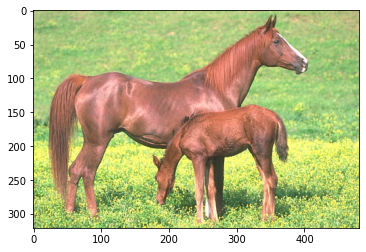

Ground Truth


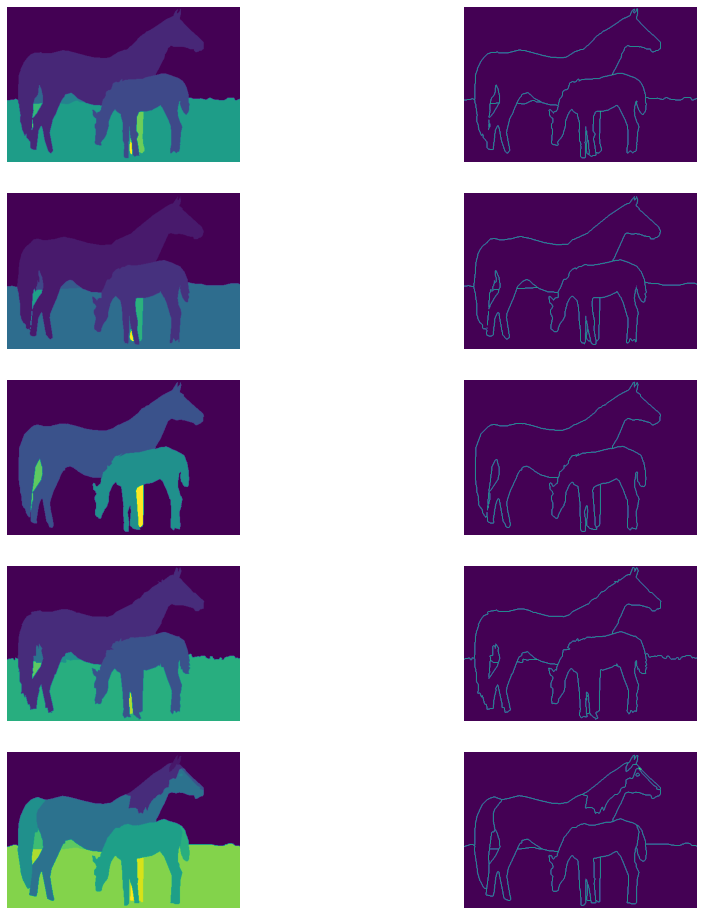

*************** Segmentation result at K = 5 | Using KMeas***************


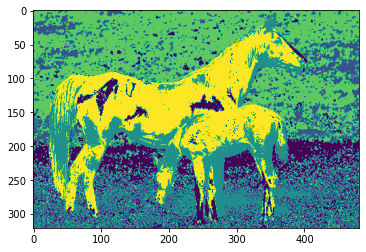

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.52
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.52
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.47
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.51
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.49
Ground Truth [ 5 ] Segment [ 0 ]: F-measure =  0.47
@ k =  5 Average F-measure of 5 ground Truth =  0.49


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


Conditional Entropy: 0.808190314229794
Conditional Entropy: 0.815228606414324
Conditional Entropy: 0.4684556502557845
Conditional Entropy: 0.8001858667541313
Conditional Entropy: 1.0323520713404268
Conditional Entropy: 0.4288694796397106
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.73
-----------------------------------------------------
************************************************************
Resized Image


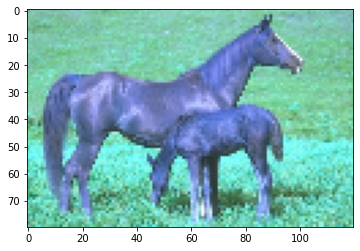

*************** Segmentation result at K = 5 | Using Spectral Clustering***************
Spectral Clustering Results


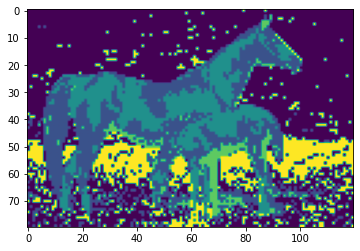

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


Conditional Entropy: 0.0706819846960427
Conditional Entropy: 0.060902883953539204
Conditional Entropy: 0.06804968548793146
Conditional Entropy: 0.08498497671207364
Conditional Entropy: 0.07204463396942243
Conditional Entropy: 0.06554644989002602
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.07
-----------------------------------------------------
************************************************************
Original Image


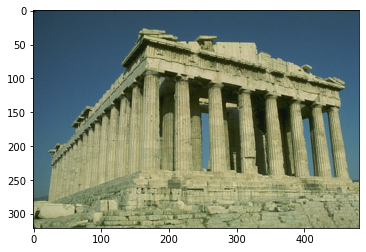

Ground Truth


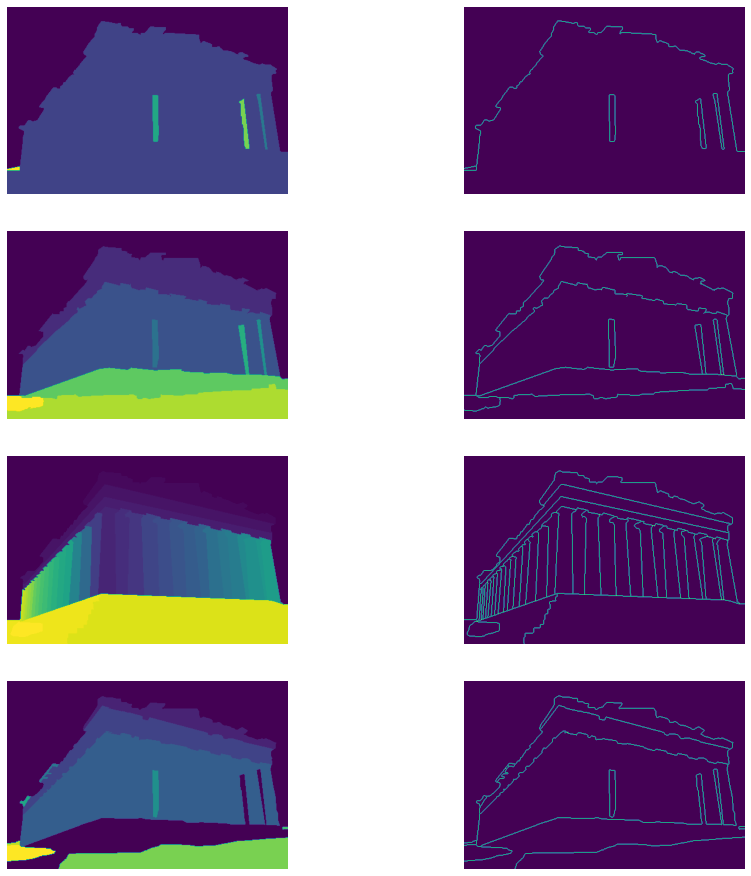

*************** Segmentation result at K = 5 | Using KMeas***************


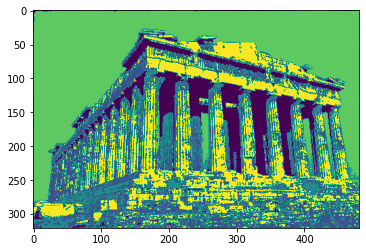

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.5
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.45
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.42
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.42
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.39
@ k =  5 Average F-measure of 5 ground Truth =  0.44
Conditional Entropy: 0.12341382935245213
Conditional Entropy: 0.9716167419097259
Conditional Entropy: 1.9459032929332956
Conditional Entropy: 1.0110025474204352
Conditional Entropy: 2.030885284900487
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  1.22
-----------------------------------------------------
************************************************************
Resized Image


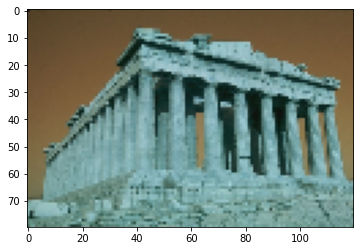

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


*************** Segmentation result at K = 5 | Using Spectral Clustering***************
Spectral Clustering Results


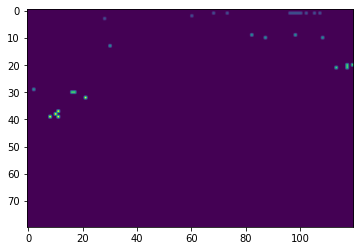

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.00
-----------------------------------------------------
************************************************************
Original Image


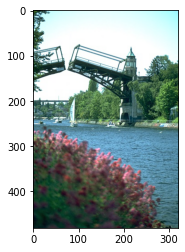

Ground Truth


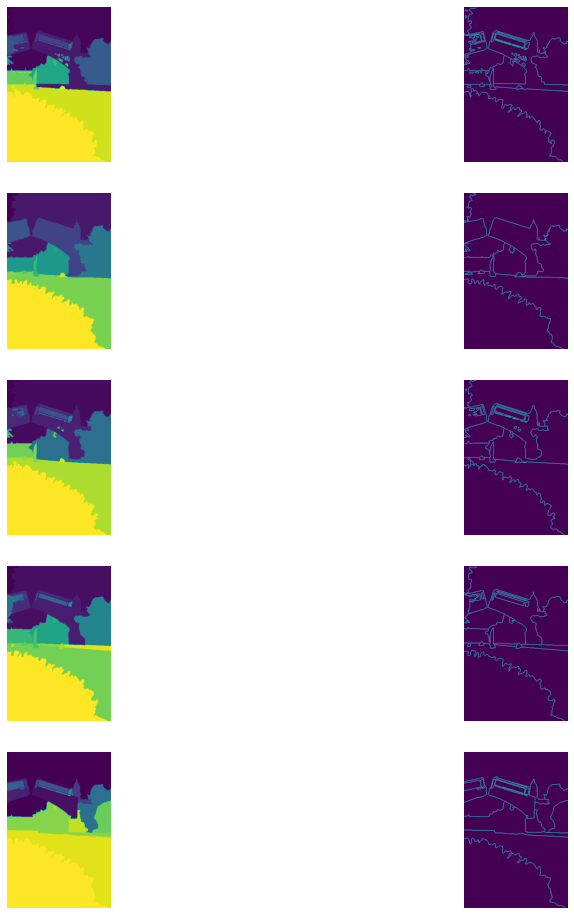

*************** Segmentation result at K = 5 | Using KMeas***************


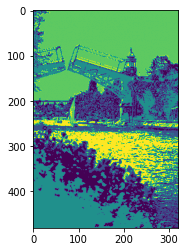

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.58
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.58
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.58
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.58
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.58
Ground Truth [ 5 ] Segment [ 0 ]: F-measure =  0.57
@ k =  5 Average F-measure of 5 ground Truth =  0.58
Conditional Entropy: 1.260258938064838
Conditional Entropy: 1.1532838522160644
Conditional Entropy: 1.1781382535607423
Conditional Entropy: 1.2881284435825016
Conditional Entropy: 1.250799029116901
Conditional Entropy: 1.4057936101963713
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  1.26
-----------------------------------------------------
************************************************************
Resized Image


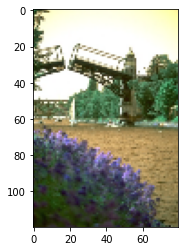

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


*************** Segmentation result at K = 5 | Using Spectral Clustering***************
Spectral Clustering Results


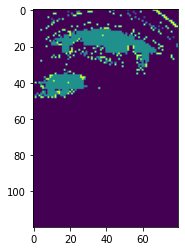

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


Conditional Entropy: 0.280041075623861
Conditional Entropy: 0.2637086680894723
Conditional Entropy: 0.2646883164558632
Conditional Entropy: 0.2700004122227843
Conditional Entropy: 0.0
Conditional Entropy: 0.24103247347366347
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.22
-----------------------------------------------------
************************************************************
Original Image


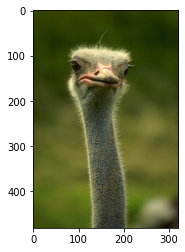

Ground Truth


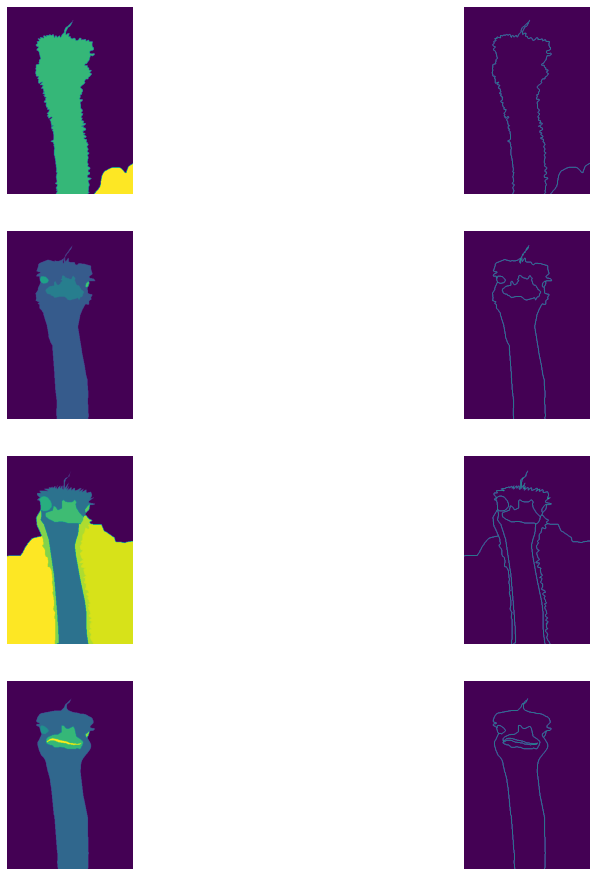

*************** Segmentation result at K = 5 | Using KMeas***************


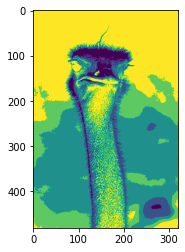

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.39
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.38
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.42
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.38
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.38
@ k =  5 Average F-measure of 5 ground Truth =  0.39
Conditional Entropy: 0.5554580362097599
Conditional Entropy: 0.5337859884078079
Conditional Entropy: 1.0992974423731758
Conditional Entropy: 0.5385426583387241
Conditional Entropy: 0.668192287920501
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.68
-----------------------------------------------------
************************************************************
Resized Image


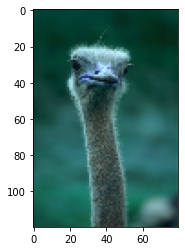

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


*************** Segmentation result at K = 5 | Using Spectral Clustering***************
Spectral Clustering Results


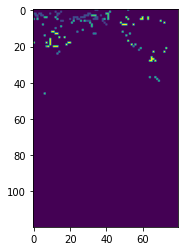

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.00
-----------------------------------------------------
************************************************************
Original Image


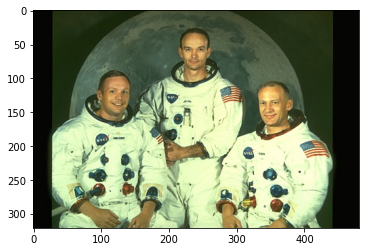

Ground Truth


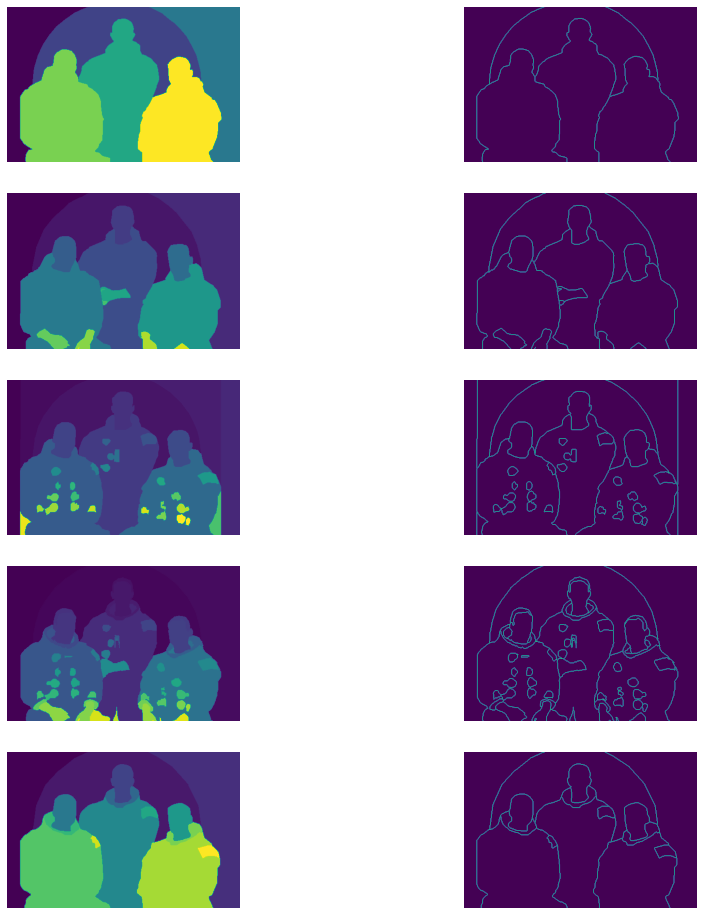

*************** Segmentation result at K = 5 | Using KMeas***************


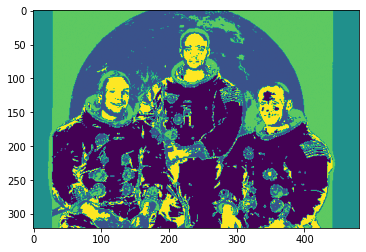

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.48
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.48
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.54
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.48
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.48
Ground Truth [ 5 ] Segment [ 0 ]: F-measure =  0.53
@ k =  5 Average F-measure of 5 ground Truth =  0.50
Conditional Entropy: 1.1084406554259771
Conditional Entropy: 1.3414307410631592
Conditional Entropy: 1.478745450528344
Conditional Entropy: 1.6003397219677182
Conditional Entropy: 1.361725607140718
Conditional Entropy: 1.65204760548119
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  1.42
-----------------------------------------------------
************************************************************
Resized Image


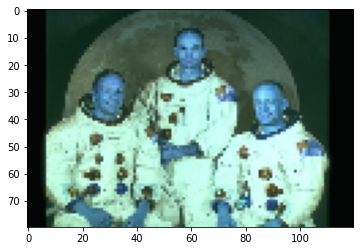

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


*************** Segmentation result at K = 5 | Using Spectral Clustering***************
Spectral Clustering Results


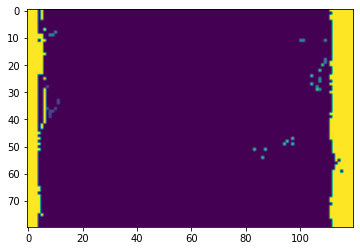

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


Conditional Entropy: 1.0925610023460892
Conditional Entropy: 1.092471666566136
Conditional Entropy: 1.4184302217844487
Conditional Entropy: 1.0923648647221031
Conditional Entropy: 1.0919089637294508
Conditional Entropy: 1.412360864645111
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  1.20
-----------------------------------------------------
************************************************************
Original Image


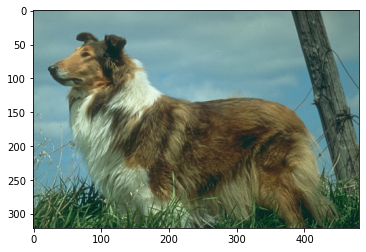

Ground Truth


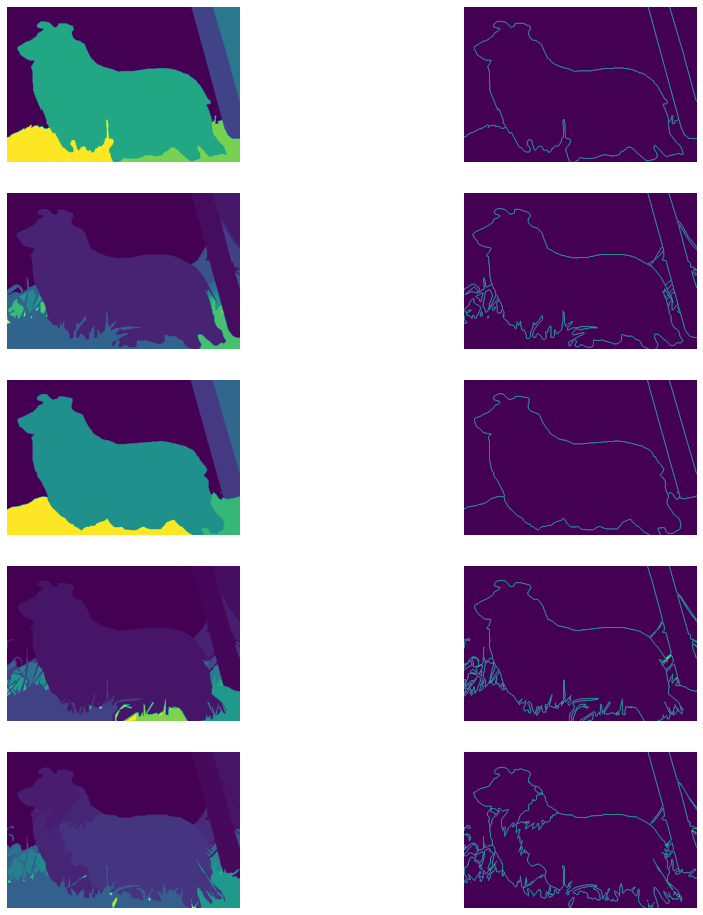

*************** Segmentation result at K = 5 | Using KMeas***************


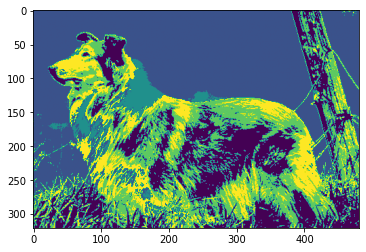

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.45
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.44
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.45
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.44
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.49
Ground Truth [ 5 ] Segment [ 0 ]: F-measure =  0.45
@ k =  5 Average F-measure of 5 ground Truth =  0.45
Conditional Entropy: 0.8078864416532204
Conditional Entropy: 1.0321190272010876
Conditional Entropy: 0.7988641912155036
Conditional Entropy: 1.0872367061139618
Conditional Entropy: 1.3187830569423615
Conditional Entropy: 0.8464950172027356
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.98
-----------------------------------------------------
************************************************************
Resized Image


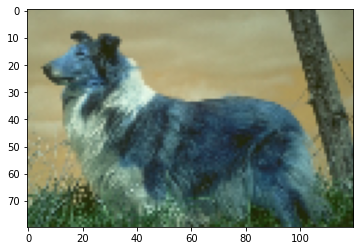

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


*************** Segmentation result at K = 5 | Using Spectral Clustering***************
Spectral Clustering Results


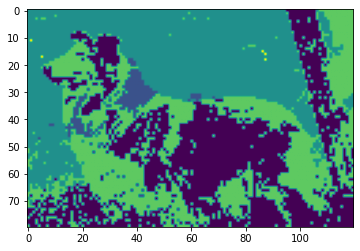

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


Conditional Entropy: 0.6371386259927813
Conditional Entropy: 0.637428734695263
Conditional Entropy: 0.6441234078577824
Conditional Entropy: 0.6418405718154451
Conditional Entropy: 0.6358883469358888
Conditional Entropy: 0.6386661395450223
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.64
-----------------------------------------------------
************************************************************
Original Image


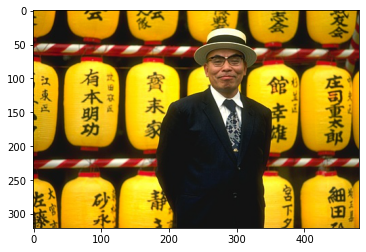

Ground Truth


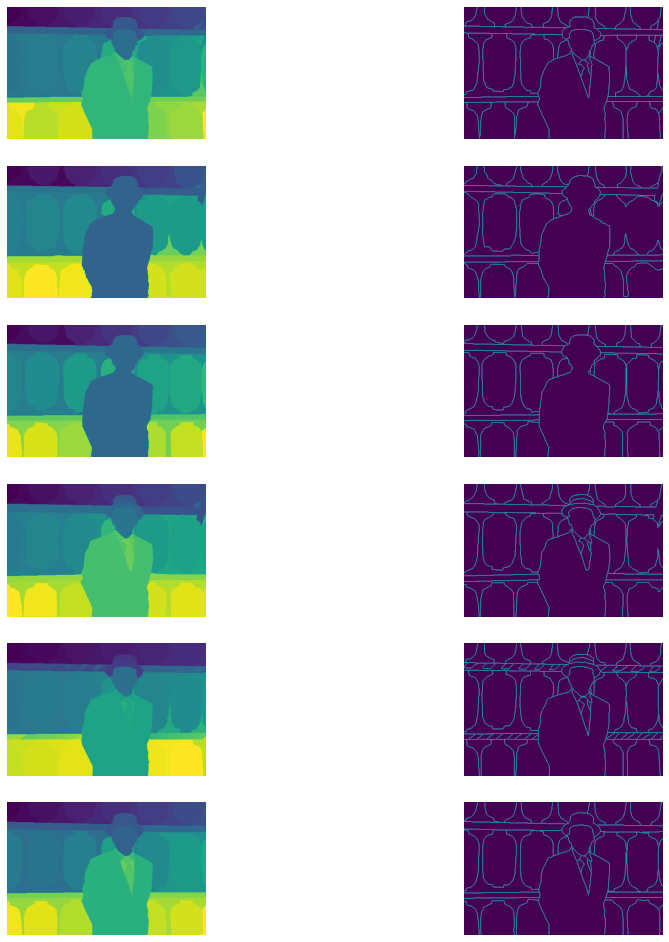

*************** Segmentation result at K = 5 | Using KMeas***************


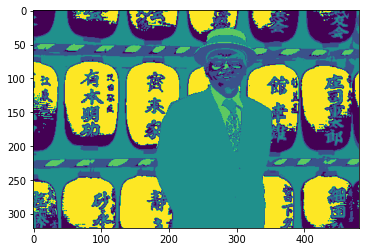

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.29
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.28
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.26
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.3
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.28
Ground Truth [ 5 ] Segment [ 0 ]: F-measure =  0.29
Ground Truth [ 6 ] Segment [ 0 ]: F-measure =  0.29
@ k =  5 Average F-measure of 5 ground Truth =  0.28
Conditional Entropy: 2.58468914107828
Conditional Entropy: 2.2981031509614347
Conditional Entropy: 2.4050268183007515
Conditional Entropy: 2.555587134661365
Conditional Entropy: 2.7235960614441472
Conditional Entropy: 2.539666936426533
Conditional Entropy: 2.4894938636579766
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  2.51
-----------------------------------------------------
************************************************************
Resized Image


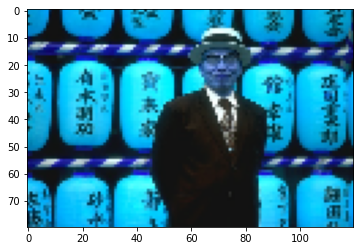

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


*************** Segmentation result at K = 5 | Using Spectral Clustering***************
Spectral Clustering Results


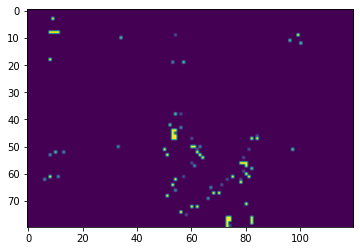

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


Conditional Entropy: 2.187820229028626
Conditional Entropy: 2.1232725563940456
Conditional Entropy: 2.1564823054629647
Conditional Entropy: 2.1905567662993253
Conditional Entropy: 2.1737099826303834
Conditional Entropy: 2.1924400853661092
Conditional Entropy: 2.120805636563383
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  2.16
-----------------------------------------------------
************************************************************
Original Image


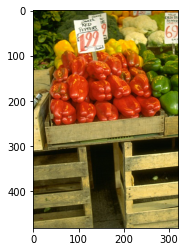

Ground Truth


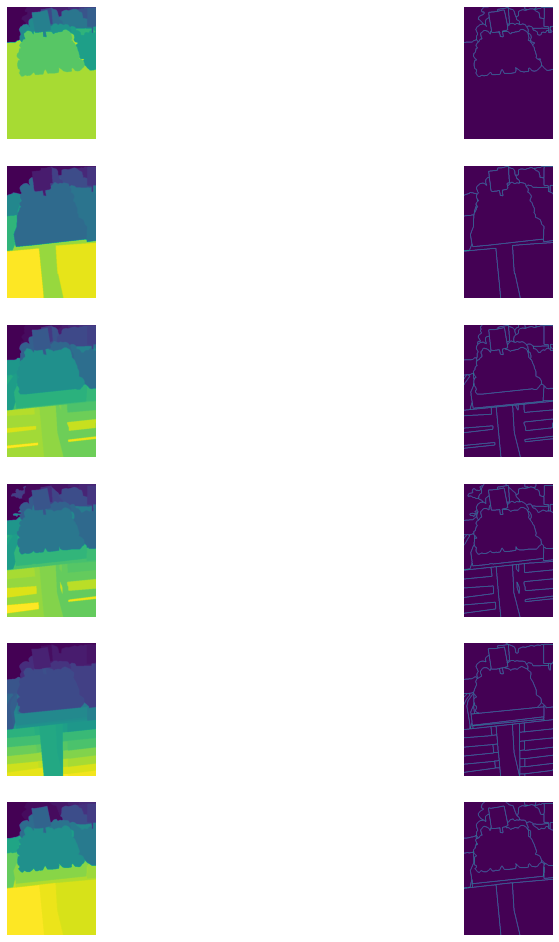

*************** Segmentation result at K = 5 | Using KMeas***************


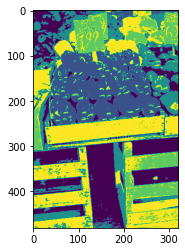

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.46
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.43
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.48
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.48
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.46
Ground Truth [ 5 ] Segment [ 0 ]: F-measure =  0.46
Ground Truth [ 6 ] Segment [ 0 ]: F-measure =  0.29
@ k =  5 Average F-measure of 5 ground Truth =  0.44
Conditional Entropy: 1.0843888170988603
Conditional Entropy: 1.5944737482462217
Conditional Entropy: 1.9541660800165408
Conditional Entropy: 2.038868372117206
Conditional Entropy: 2.2569691247553223
Conditional Entropy: 1.8316415399205783
Conditional Entropy: 2.7105747809808713
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  1.92
-----------------------------------------------------
************************************************************
Resized Image


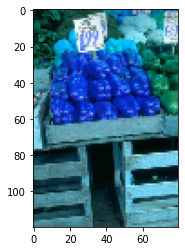

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


*************** Segmentation result at K = 5 | Using Spectral Clustering***************
Spectral Clustering Results


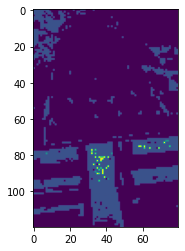

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


Conditional Entropy: 2.208210327500218
Conditional Entropy: 1.6631058538044836
Conditional Entropy: 2.1926906889959143
Conditional Entropy: 2.220155325283371
Conditional Entropy: 1.5505334682199878
Conditional Entropy: 1.9940892467890112
Conditional Entropy: 2.1115220315566257
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  1.99
-----------------------------------------------------
************************************************************
Original Image


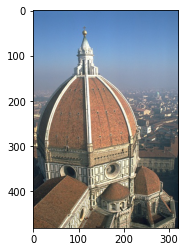

Ground Truth


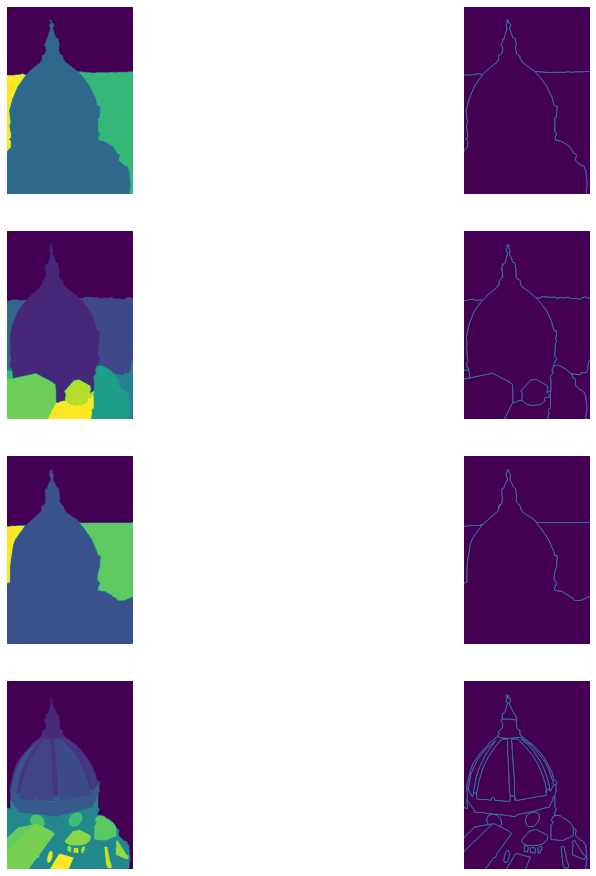

*************** Segmentation result at K = 5 | Using KMeas***************


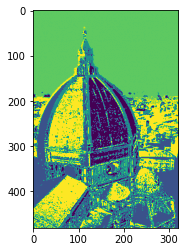

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.49
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.45
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.49
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.43
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.48
@ k =  5 Average F-measure of 5 ground Truth =  0.47
Conditional Entropy: 0.47139952857862544
Conditional Entropy: 1.0678775590651928
Conditional Entropy: 0.4401681475369503
Conditional Entropy: 1.3697700830834614
Conditional Entropy: 1.5605984679956628
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.98
-----------------------------------------------------
************************************************************
Resized Image


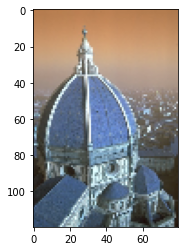

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


*************** Segmentation result at K = 5 | Using Spectral Clustering***************
Spectral Clustering Results


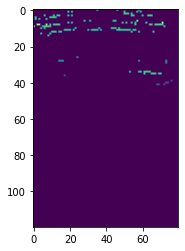

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.00
-----------------------------------------------------
************************************************************
Original Image


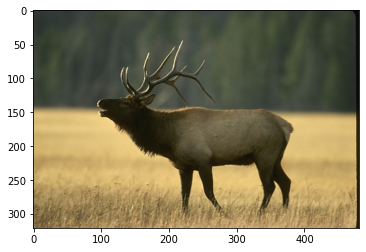

Ground Truth


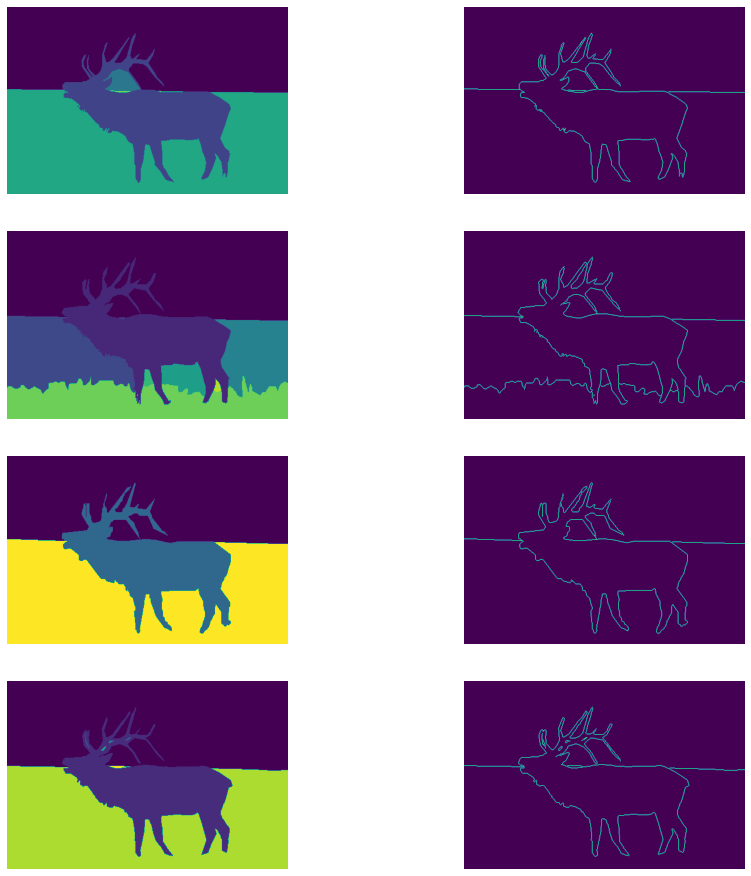

*************** Segmentation result at K = 5 | Using KMeas***************


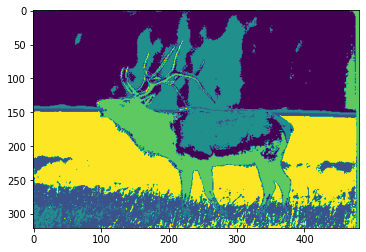

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.59
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.61
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.59
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.6
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.6
@ k =  5 Average F-measure of 5 ground Truth =  0.60
Conditional Entropy: 0.40285043315495317
Conditional Entropy: 0.7516314864575699
Conditional Entropy: 0.3753944174996667
Conditional Entropy: 0.3589152288630335
Conditional Entropy: 0.44119043339862396
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.47
-----------------------------------------------------
************************************************************
Resized Image


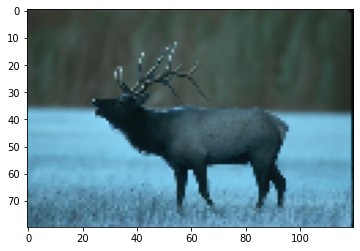

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


*************** Segmentation result at K = 5 | Using Spectral Clustering***************
Spectral Clustering Results


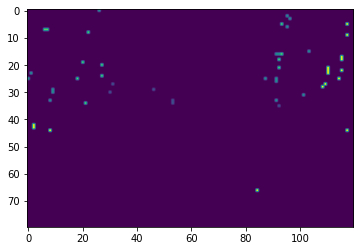

Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
Conditional Entropy: 0.0
-----------------------------------------------------
@ k =  5 Average Conditional Entropy of 5 ground Truth =  0.00
-----------------------------------------------------
************************************************************


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


In [ ]:
images = ['113044','67079','22093','66075','323016','247085','65019','25098','24004','41004']
groundTruthAgainstSegResults(images)

----------------------------------------------------------------------------------------------

##Spectral Clustering

In [ ]:
import numpy as np
import scipy.io
import glob
from PIL import Image
from scipy import io
import pandas as pd
import os
import cv2
import matplotlib.pyplot as plt
from scipy.spatial import distance

In [ ]:
from sklearn.cluster import SpectralClustering
def getSegmentedNCuts(img_array,Ks):
  h = len(img_array)
  w = len(img_array[0])
  img_array = img_array.reshape(h*w,3)

  segmented_results = np.empty([len(Ks),h,w])
  for k,i in zip((Ks),range(len(Ks))):
    seg = (SpectralClustering(n_clusters=k, affinity='nearest_neighbors', n_neighbors=5,n_jobs=-1, eigen_solver='arpack').fit(img_array))
    segmented_results[i] = np.array([j for j in seg.labels_]).reshape(h,w)
  return (segmented_results)

def ShowSegmentedNCuts(segmented_results):
  print("Spectral Clustering Results")
  for i in range(len(segmented_results)):
    plt.imshow(segmented_results[i])
    plt.show()

Original Image


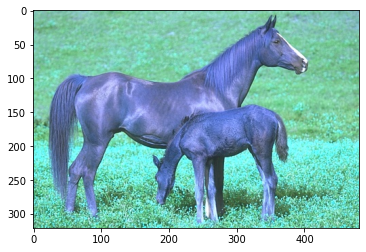

Resized Image


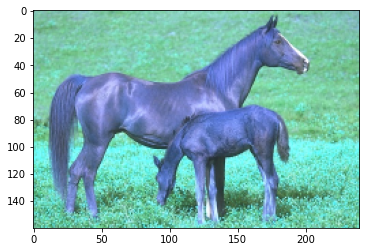

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


Spectral Clustering Results


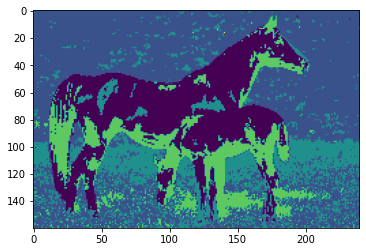

In [ ]:
from google.colab.patches import cv2_imshow
import cv2

img = cv2.imread('/content/BSR/BSDS500/data/images/train/113044.jpg', cv2.IMREAD_UNCHANGED)
im_array = np.asarray(img)
print("Original Image")
plt.imshow(im_array)
plt.show()
pil_im = cv2.resize(img, (0, 0), fx = 0.5, fy = 0.5)
im_array = np.asarray(pil_im)
print("Resized Image")
plt.imshow(im_array)
plt.show()
segmented_results = getSegmentedNCuts(im_array,np.array([5]))
ShowSegmentedNCuts(segmented_results)

Original Image


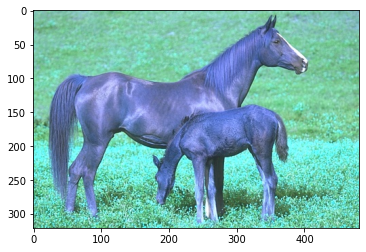

Resized Image


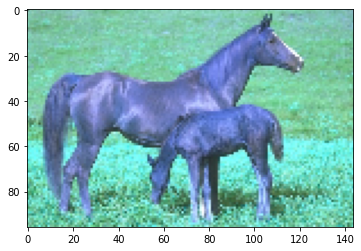

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


Spectral Clustering Results


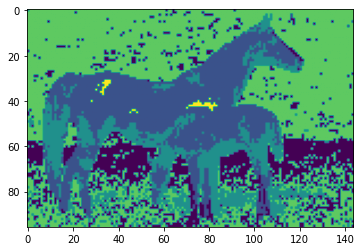

In [ ]:
from google.colab.patches import cv2_imshow
import cv2

img = cv2.imread('/content/BSR/BSDS500/data/images/train/113044.jpg', cv2.IMREAD_UNCHANGED)
im_array = np.asarray(img)
print("Original Image")
plt.imshow(im_array)
plt.show()
pil_im = cv2.resize(img, (0, 0), fx = 0.3, fy = 0.3)
im_array = np.asarray(pil_im)
print("Resized Image")
plt.imshow(im_array)
plt.show()
segmented_results = getSegmentedNCuts(im_array,np.array([5]))
ShowSegmentedNCuts(segmented_results)

Original Image


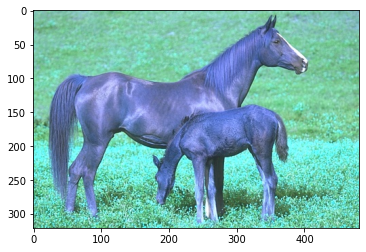

Resized Image


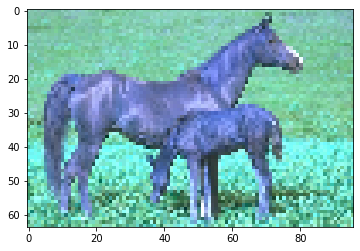

Spectral Clustering Results


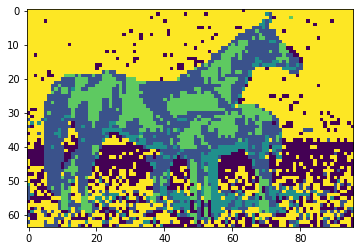

In [ ]:
from google.colab.patches import cv2_imshow
import cv2

img = cv2.imread('/content/BSR/BSDS500/data/images/train/113044.jpg', cv2.IMREAD_UNCHANGED)
im_array = np.asarray(img)
print("Original Image")
plt.imshow(im_array)
plt.show()
pil_im = cv2.resize(img, (0, 0), fx = 0.2, fy = 0.2)
im_array = np.asarray(pil_im)
print("Resized Image")
plt.imshow(im_array)
plt.show()
segmented_results = getSegmentedNCuts(im_array,np.array([5]))
ShowSegmentedNCuts(segmented_results)

Original Image


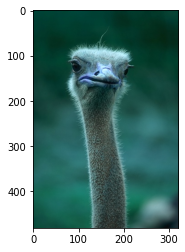

Resized Image


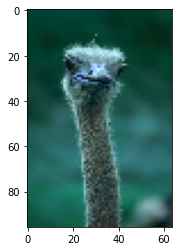

/usr/local/lib/python3.7/dist-packages/sklearn/manifold/_spectral_embedding.py:261: UserWarning: Graph is not fully connected, spectral embedding may not work as expected.
  "Graph is not fully connected, spectral embedding may not work as expected."


Spectral Clustering Results


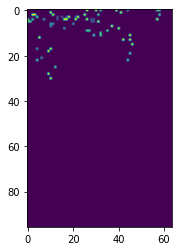

In [ ]:
from google.colab.patches import cv2_imshow
import cv2

img = cv2.imread('/content/BSR/BSDS500/data/images/train/66075.jpg', cv2.IMREAD_UNCHANGED)
im_array = np.asarray(img)
print("Original Image")
plt.imshow(im_array)
plt.show()
pil_im = cv2.resize(img, (0, 0), fx = 0.2, fy = 0.2)
im_array = np.asarray(pil_im)
print("Resized Image")
plt.imshow(im_array)
plt.show()
segmented_results = getSegmentedNCuts(im_array,np.array([5]))
ShowSegmentedNCuts(segmented_results)

## KMeans50

Original Image


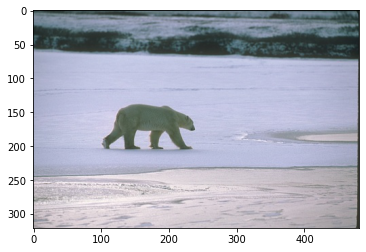

KMeans Results


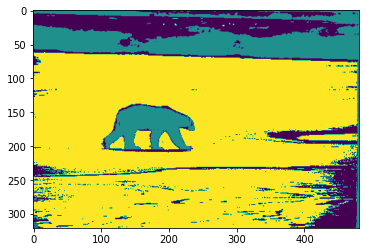

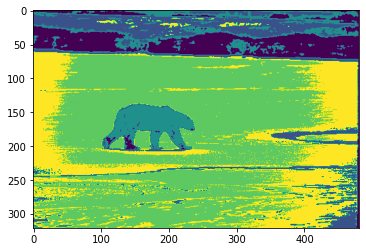

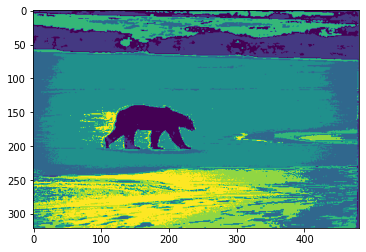

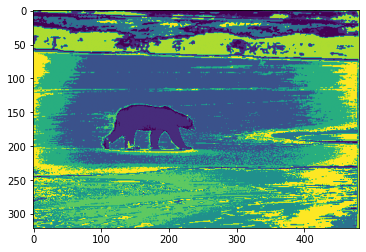

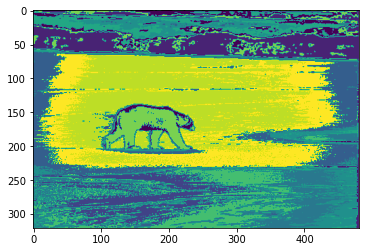

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.63
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.63
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.68
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.6
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.67
@ k =  3 Average F-measure of 5 ground Truth =  0.64
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.48
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.48
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.55
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.47
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.6
@ k =  5 Average F-measure of 5 ground Truth =  0.51
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.5
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.5
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.57
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.49
Ground T

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  # This is added back by InteractiveShellApp.init_path()


-------------------------------------------
0 'th cluster =>  [1 1 1 ... 5 5 5]
Sum of Elements: [12444  5804   601   459  6655]
-------------------------------------------
1 'th cluster =>  [1 1 1 ... 5 5 5]
Sum of Elements: [18909   641  4818    28   247]
-------------------------------------------
2 'th cluster =>  [1 1 1 ... 5 5 5]
Sum of Elements: [   36 69436   113   729 33481]
Conditional Entropy: 0.7644243195523768
-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-
-------------------------------------------
0 'th cluster =>  [1 1 1 ... 7 7 7]
Sum of Elements: [12403  4125   603   310   956   201  7365]
-------------------------------------------
1 'th cluster =>  [1 1 1 ... 7 7 7]
Sum of Elements: [18945   601  4799     0     6    30   262]
-------------------------------------------
2 'th cluster =>  [1 1 1 ... 7 7 7]
Sum of Elements: [   36 68606   134   698    41   728 33552]
Conditional Entropy: 0.8109417937566958
-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*-*

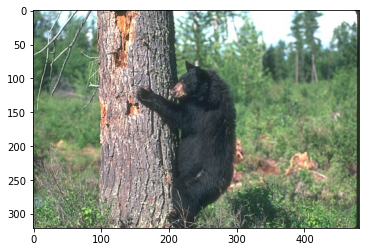

KMeans Results


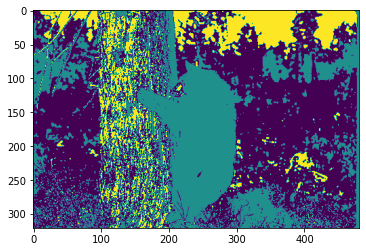

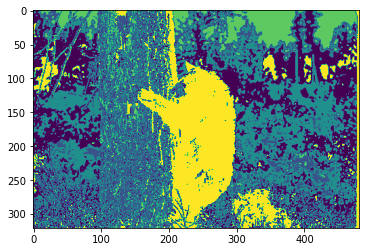

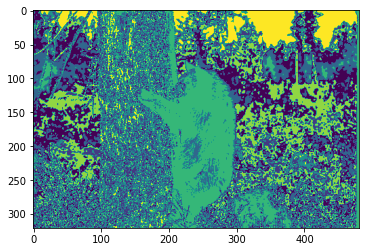

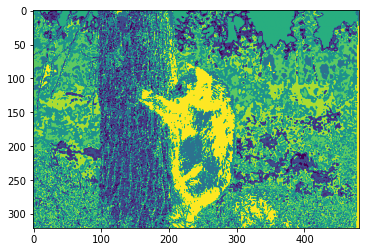

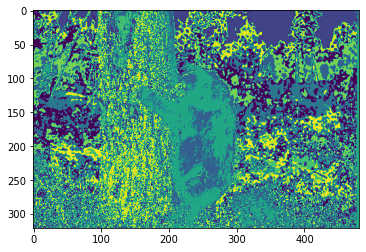

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.51
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.47
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.52
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.51
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.51
@ k =  3 Average F-measure of 5 ground Truth =  0.51
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.44
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.41
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.44
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.44
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.44
@ k =  5 Average F-measure of 5 ground Truth =  0.44
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.36
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.38
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.36
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.36
Grou

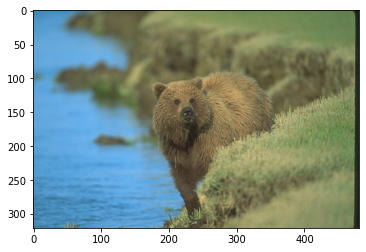

KMeans Results


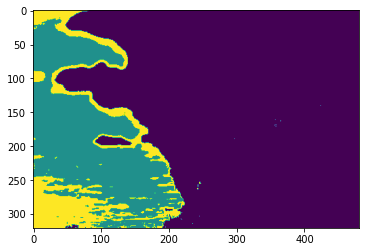

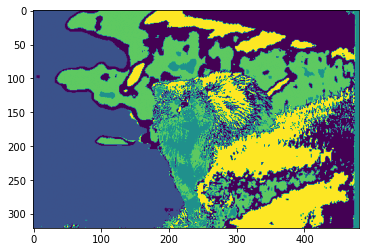

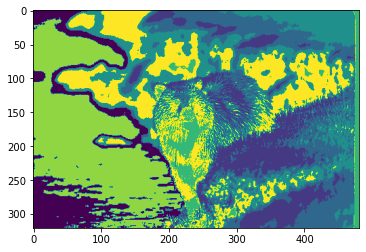

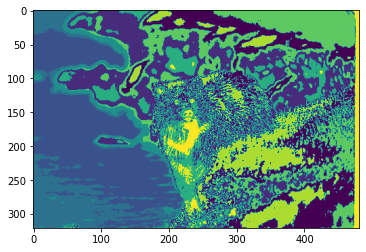

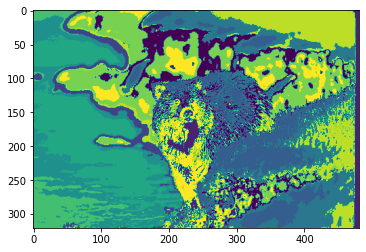

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.63
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.64
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.63
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.59
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.64
@ k =  3 Average F-measure of 5 ground Truth =  0.62
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.57
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.6
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.57
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.57
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.6
@ k =  5 Average F-measure of 5 ground Truth =  0.58
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.48
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.48
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.47
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.48
Ground

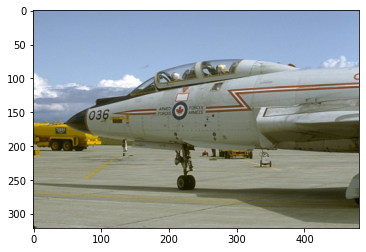

KMeans Results


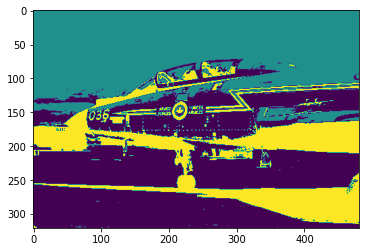

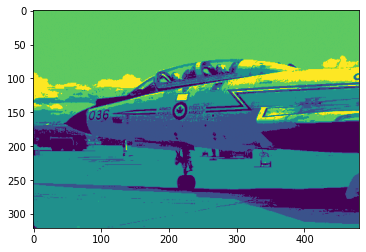

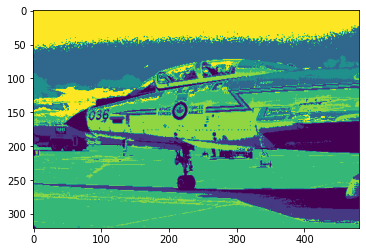

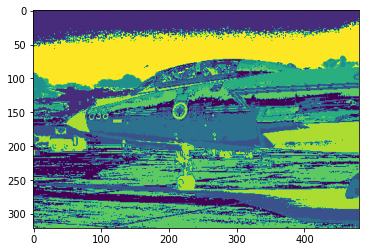

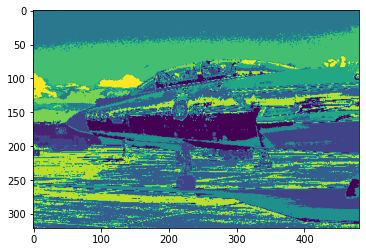

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.67
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.67
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.66
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.66
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.61
@ k =  3 Average F-measure of 5 ground Truth =  0.65
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.53
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.52
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.52
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.53
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.51
@ k =  5 Average F-measure of 5 ground Truth =  0.52
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.44
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.43
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.43
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.44
Grou

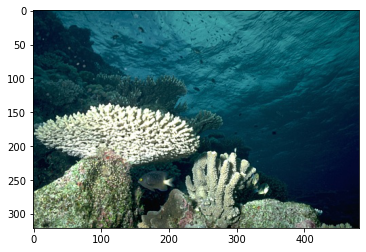

KMeans Results


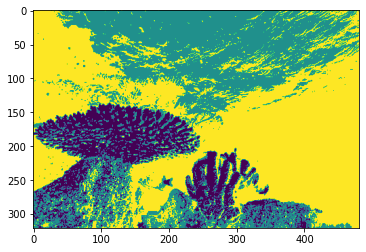

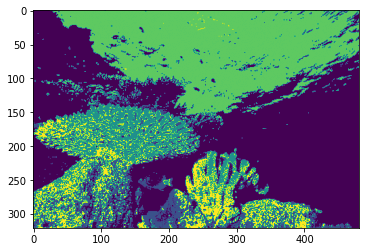

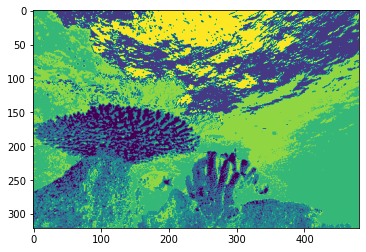

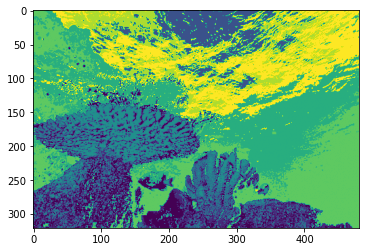

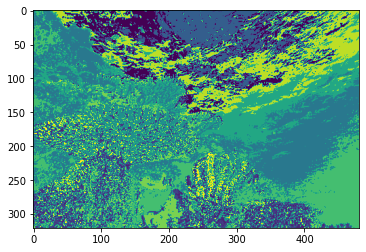

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.55
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.55
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.54
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.55
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.57
@ k =  3 Average F-measure of 5 ground Truth =  0.55
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.5
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.47
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.49
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.49
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.5
@ k =  5 Average F-measure of 5 ground Truth =  0.49
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.4
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.38
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.39
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.39
Ground 

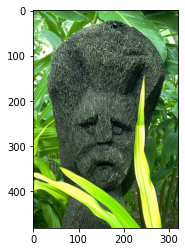

KMeans Results


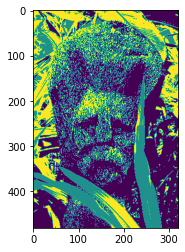

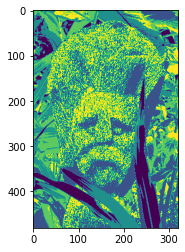

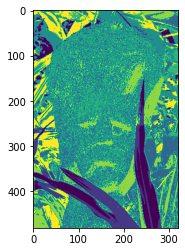

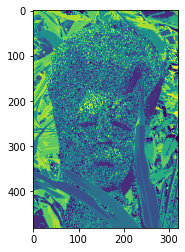

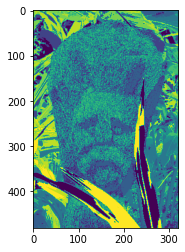

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.52
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.52
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.52
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.49
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.5
Ground Truth [ 5 ] Segment [ 0 ]: F-measure =  0.48
@ k =  3 Average F-measure of 5 ground Truth =  0.60
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.5
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.5
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.5
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.41
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.49
Ground Truth [ 5 ] Segment [ 1 ]: F-measure =  0.47
@ k =  5 Average F-measure of 5 ground Truth =  0.57
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.44
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.44
Ground T

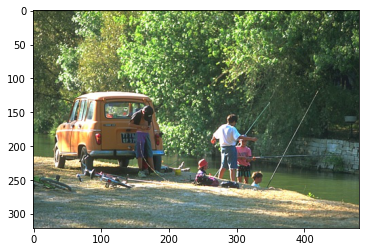

KMeans Results


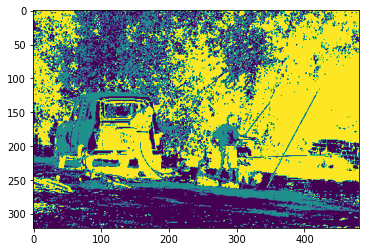

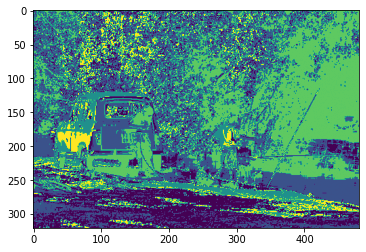

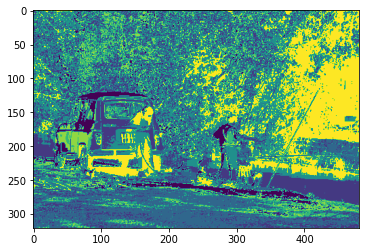

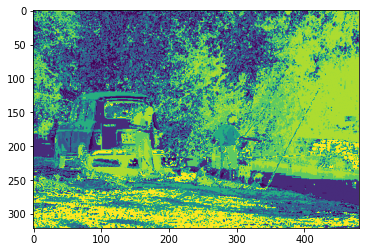

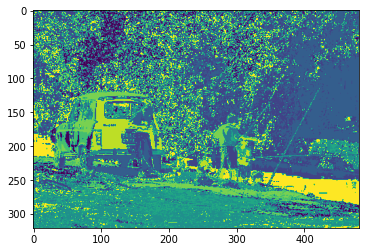

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.43
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.38
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.46
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.44
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.38
@ k =  3 Average F-measure of 5 ground Truth =  0.42
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.34
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.36
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.31
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.35
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.35
@ k =  5 Average F-measure of 5 ground Truth =  0.34
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.29
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.3
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.24
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.3
Ground

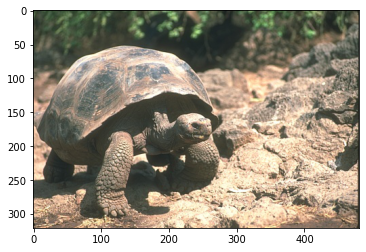

KMeans Results


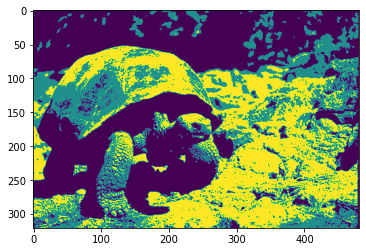

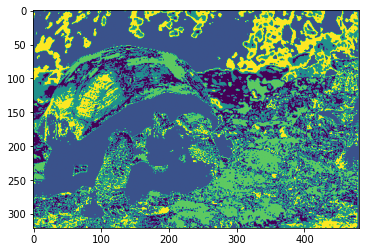

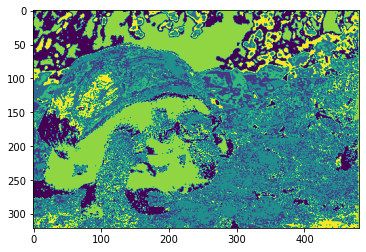

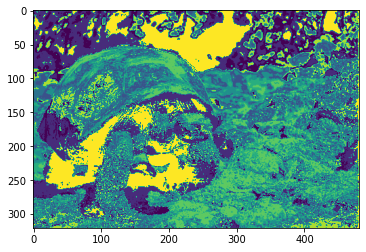

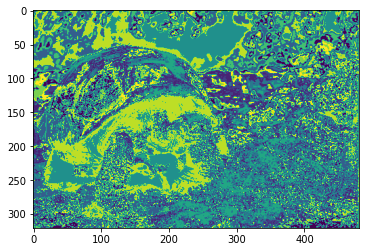

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.52
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.52
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.42
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.44
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.47
@ k =  3 Average F-measure of 5 ground Truth =  0.47
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.38
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.36
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.29
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.35
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.37
@ k =  5 Average F-measure of 5 ground Truth =  0.35
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.3
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.3
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.23
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.29
Ground

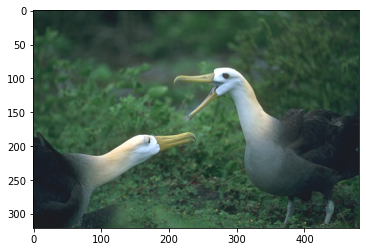

KMeans Results


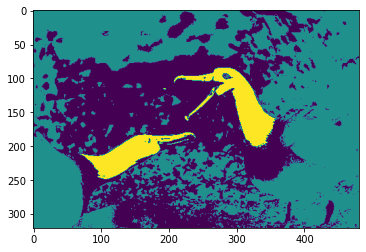

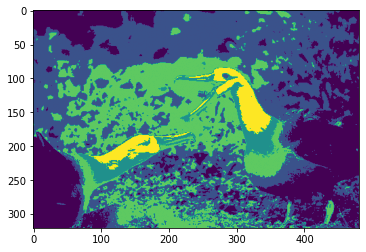

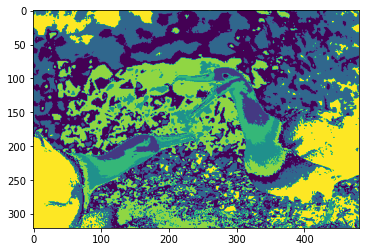

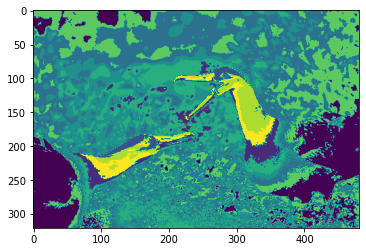

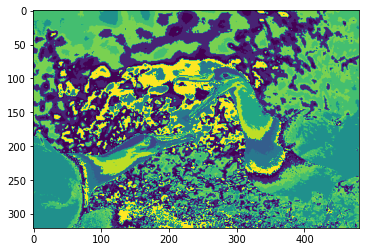

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.42
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.51
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.41
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.42
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.5
Ground Truth [ 5 ] Segment [ 0 ]: F-measure =  0.48
Ground Truth [ 6 ] Segment [ 0 ]: F-measure =  0.5
Ground Truth [ 7 ] Segment [ 0 ]: F-measure =  0.54
@ k =  3 Average F-measure of 5 ground Truth =  0.76
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.34
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.36
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.34
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.34
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.35
Ground Truth [ 5 ] Segment [ 1 ]: F-measure =  0.43
Ground Truth [ 6 ] Segment [ 1 ]: F-measure =  0.35
Ground Truth [ 7 ] Segment [ 1 ]: F-measure =  0.39
@ k =  5 

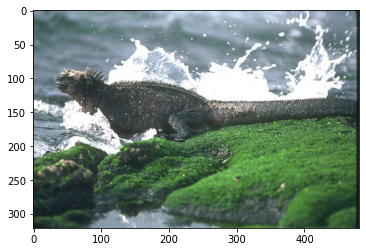

KMeans Results


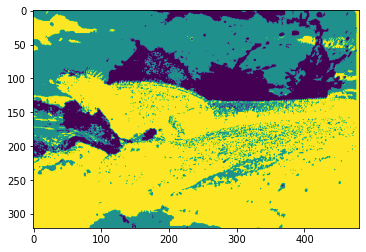

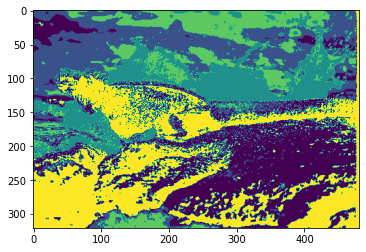

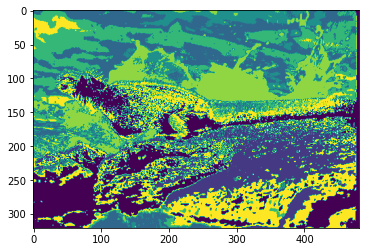

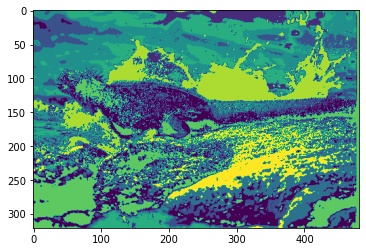

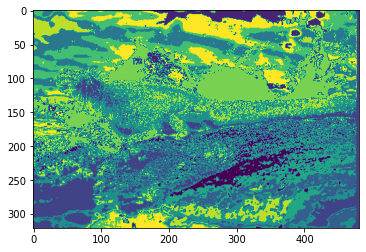

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.72
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.76
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.75
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.68
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.65
@ k =  3 Average F-measure of 5 ground Truth =  0.71
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.57
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.59
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.59
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.54
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.5
@ k =  5 Average F-measure of 5 ground Truth =  0.56
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.47
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.48
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.48
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.46
Groun

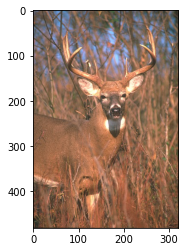

KMeans Results


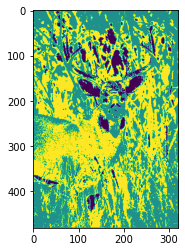

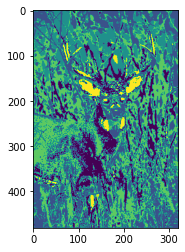

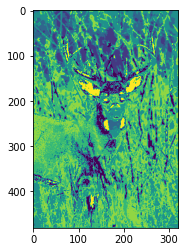

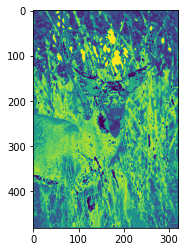

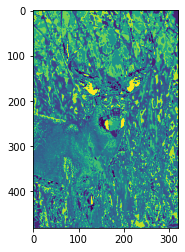

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.41
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.46
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.51
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.41
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.38
@ k =  3 Average F-measure of 5 ground Truth =  0.43
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.35
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.32
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.36
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.31
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.32
@ k =  5 Average F-measure of 5 ground Truth =  0.33
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.26
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.26
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.26
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.26
Grou

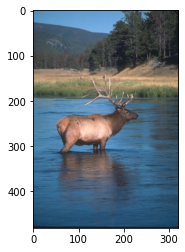

KMeans Results


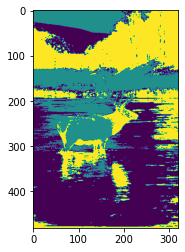

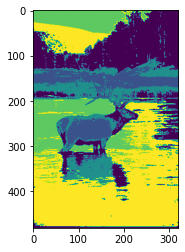

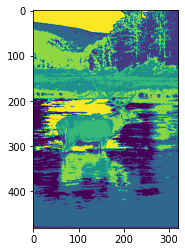

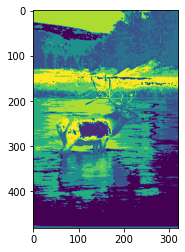

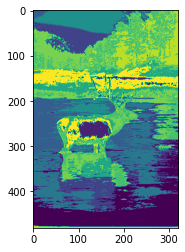

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.63
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.55
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.63
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.57
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.6
Ground Truth [ 5 ] Segment [ 0 ]: F-measure =  0.62
@ k =  3 Average F-measure of 5 ground Truth =  0.72
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.54
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.43
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.54
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.46
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.52
Ground Truth [ 5 ] Segment [ 1 ]: F-measure =  0.53
@ k =  5 Average F-measure of 5 ground Truth =  0.60
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.49
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.46
Groun

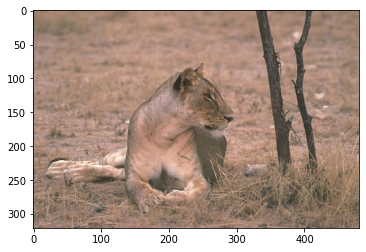

KMeans Results


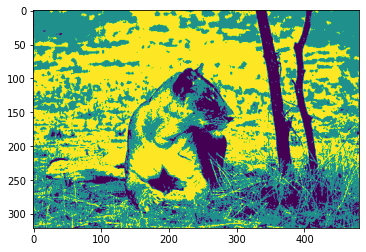

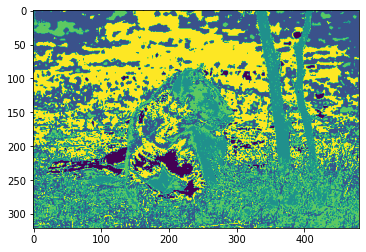

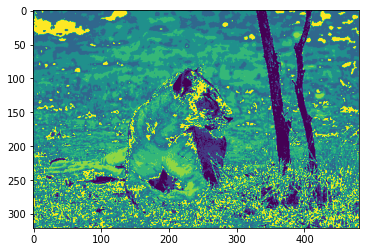

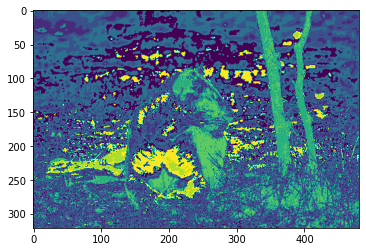

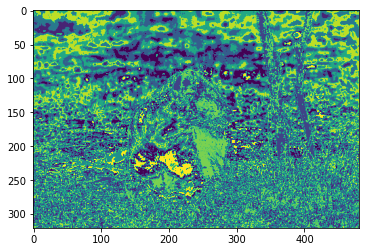

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.44
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.44
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.44
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.44
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.44
@ k =  3 Average F-measure of 5 ground Truth =  0.44
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.37
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.37
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.37
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.37
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.37
@ k =  5 Average F-measure of 5 ground Truth =  0.37
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.31
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.31
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.31
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.31
Grou

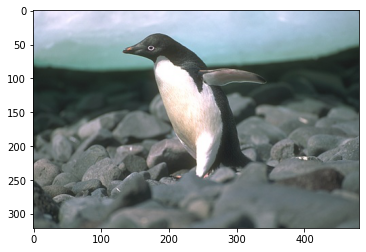

KMeans Results


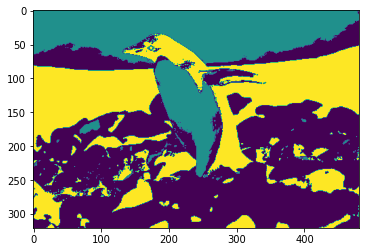

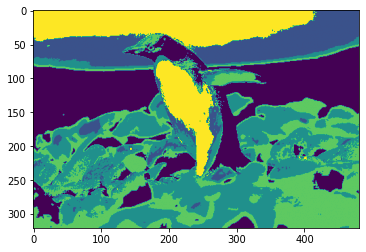

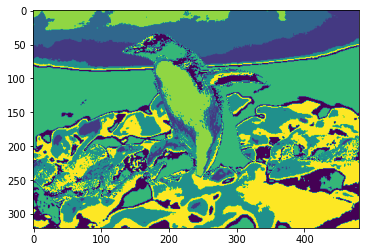

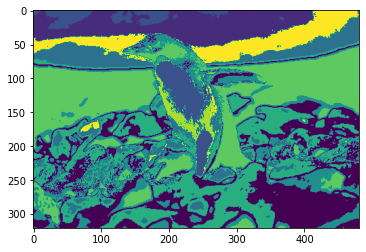

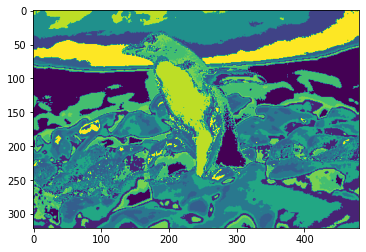

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.6
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.67
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.67
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.67
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.59
@ k =  3 Average F-measure of 5 ground Truth =  0.64
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.55
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.51
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.52
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.51
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.51
@ k =  5 Average F-measure of 5 ground Truth =  0.52
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.47
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.43
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.43
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.45
Groun

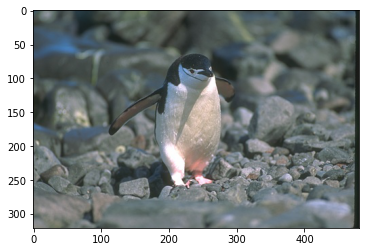

KMeans Results


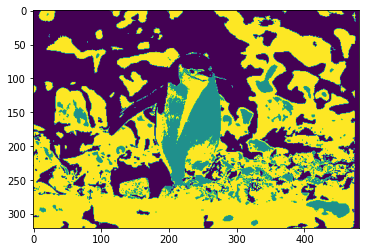

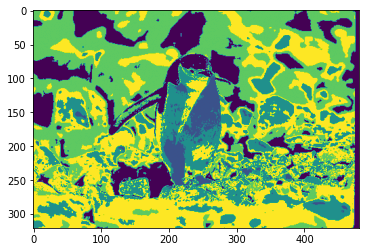

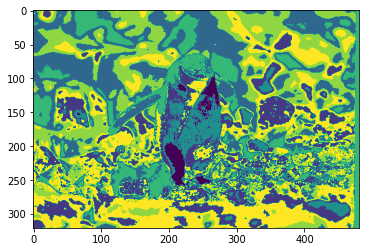

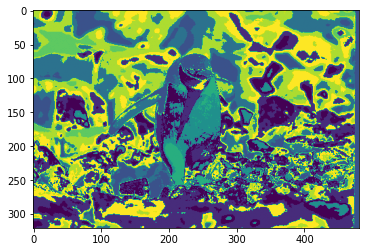

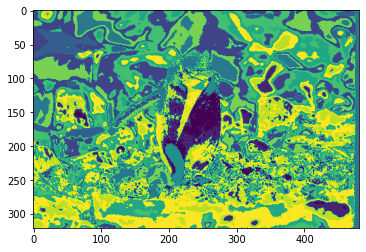

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.51
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.59
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.59
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.61
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.56
@ k =  3 Average F-measure of 5 ground Truth =  0.57
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.38
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.39
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.39
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.41
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.44
@ k =  5 Average F-measure of 5 ground Truth =  0.40
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.35
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.31
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.31
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.34
Grou

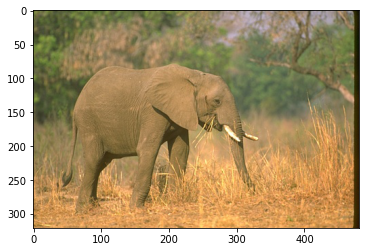

KMeans Results


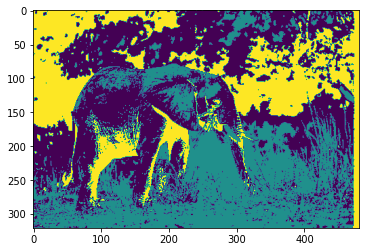

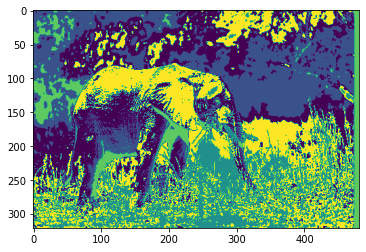

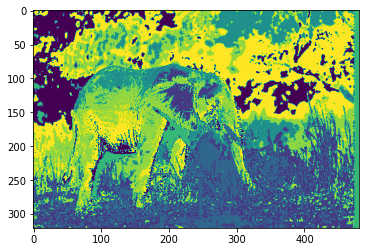

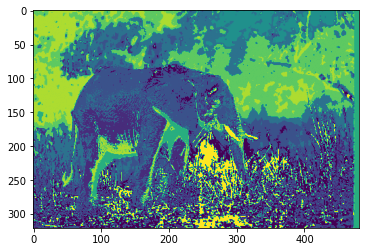

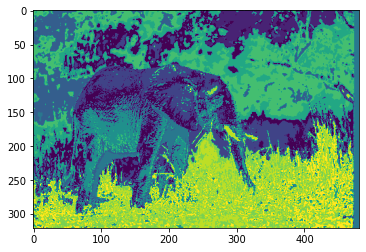

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.55
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.55
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.57
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.55
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.58
@ k =  3 Average F-measure of 5 ground Truth =  0.56
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.4
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.4
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.42
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.4
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.43
@ k =  5 Average F-measure of 5 ground Truth =  0.41
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.36
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.37
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.36
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.42
Ground 

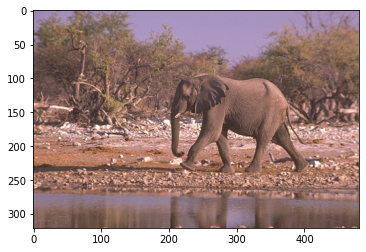

KMeans Results


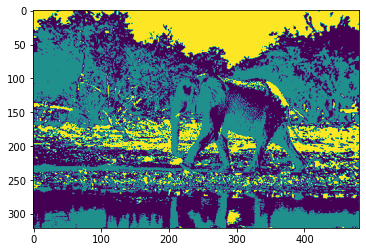

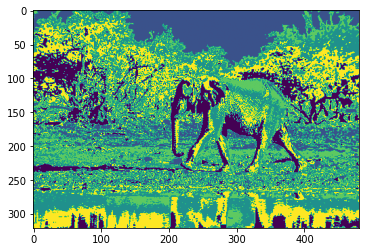

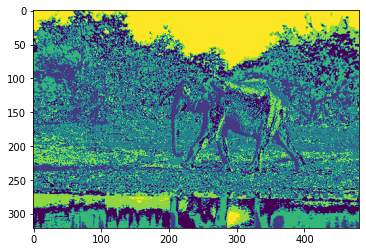

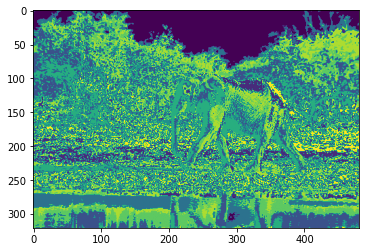

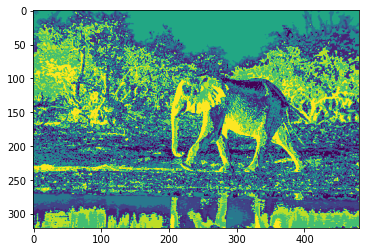

-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 0 ]: F-measure =  0.43
Ground Truth [ 1 ] Segment [ 0 ]: F-measure =  0.42
Ground Truth [ 2 ] Segment [ 0 ]: F-measure =  0.42
Ground Truth [ 3 ] Segment [ 0 ]: F-measure =  0.42
Ground Truth [ 4 ] Segment [ 0 ]: F-measure =  0.42
@ k =  3 Average F-measure of 5 ground Truth =  0.42
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 1 ]: F-measure =  0.4
Ground Truth [ 1 ] Segment [ 1 ]: F-measure =  0.42
Ground Truth [ 2 ] Segment [ 1 ]: F-measure =  0.39
Ground Truth [ 3 ] Segment [ 1 ]: F-measure =  0.37
Ground Truth [ 4 ] Segment [ 1 ]: F-measure =  0.43
@ k =  5 Average F-measure of 5 ground Truth =  0.40
-----------------------------------------------------
Ground Truth [ 0 ] Segment [ 2 ]: F-measure =  0.34
Ground Truth [ 1 ] Segment [ 2 ]: F-measure =  0.39
Ground Truth [ 2 ] Segment [ 2 ]: F-measure =  0.34
Ground Truth [ 3 ] Segment [ 2 ]: F-measure =  0.34
Groun

In [ ]:
KMeans50()

## Extra

In [ ]:
def kmeans(X,k,max_iterations=100):
    if isinstance(X, pd.DataFrame):X = X.values
    idx = np.random.choice(len(X), k, replace=False)
    centroids = X[idx, :]
   
    P = np.argmin(distance.cdist(X, centroids, 'euclidean'),axis=1)
  
    for _ in range(max_iterations):
        centroids = np.vstack([X[P==i,:].mean(axis=0) for i in range(k)])
        tmp = np.argmin(distance.cdist(X, centroids, 'euclidean'),axis=1)
        if np.array_equal(P,tmp):break
        P = tmp

    return P

In [ ]:
def kmeansWithLayout(X,k,max_iterations=100):
    if isinstance(X, pd.DataFrame):X = X.values
    idx = np.random.choice(len(X), k, replace=False)
    centroids = X[idx, :]
   
    P = np.argmin(newDistance(X,centroids),axis=1)
  
    for _ in range(max_iterations):
        centroids = np.vstack([X[P==i,:].mean(axis=0) for i in range(k)])
        tmp = np.argmin(newDistance(X,centroids),axis=1)
        if np.array_equal(P,tmp):break
        P = tmp
    return P

In [ ]:
def newDistance(X,centroids) :
  h = len(X) 
  k = len(centroids)
  result = np.zeros((h,k))

  for i in range(h) :
    for j in range(k) :
      RGB = 0 
      for u in range(3) :
        RGB += ( X[i][u] - centroids[j][u]) ** 2
      
      myDistance = 0 
      for u in range(3,5) :
        myDistance +=  ( X[i][u] - centroids[j][u]) ** 2

      RGB *= 16
      RGB += myDistance 

      result[i][j] = np.sqrt(RGB)
  
  
  return result
      

In [ ]:
def getSegmentedKMeans(img_array,Ks,withLayout=False):
  h = len(img_array)
  w = len(img_array[0])
  img_array = img_array.reshape(154401,3)

  if (withLayout) :
    new_image = list()
    
    for firstIndex in range (h) :
      for secondIndex in range (w) :
        new_image.append(np.append(img_array[firstIndex*w+secondIndex],[firstIndex,secondIndex]))

    img_array = np.array(new_image)

  segmented_results = np.empty([len(Ks),h,w])
  for k,i in zip((Ks),range(len(Ks))):
    if (withLayout) :
      seg = kmeansWithLayout(img_array,k)
    else :
      seg = kmeans(img_array,k)

    segmented_results[i] = np.array(seg).reshape(h,w)
    #print(segmented_results[i].shape)
    #plt.imshow(segmented_results[i])
    #plt.show()

  return (segmented_results)
  
def ShowSegmentedKMeans(segmented_results):
  for i in range(len(segmented_results)):
    plt.imshow(segmented_results[i])
    plt.show()

**********************************************************************************************
**********************************************************************************************


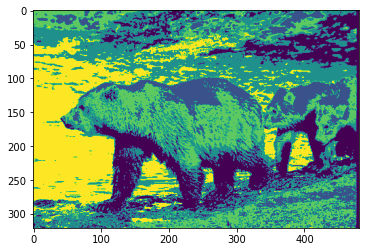

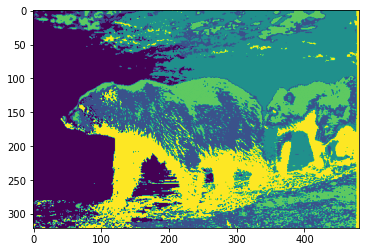

**********************************************************************************************
**********************************************************************************************


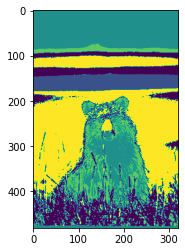

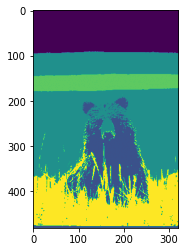

**********************************************************************************************
**********************************************************************************************


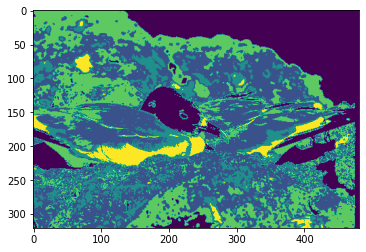

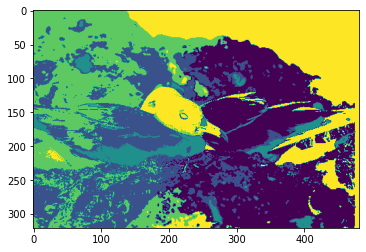

**********************************************************************************************
**********************************************************************************************


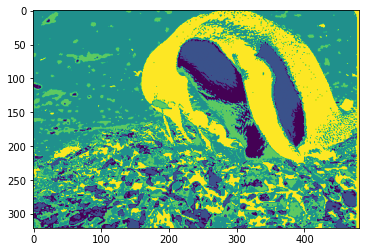

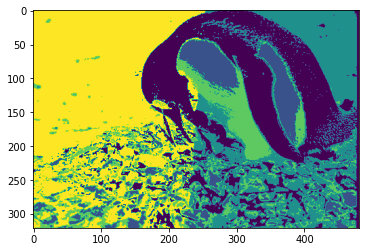

**********************************************************************************************
**********************************************************************************************


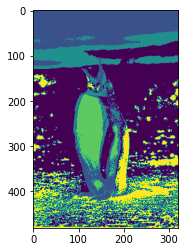

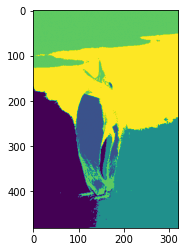

In [ ]:
# filename = glob.glob("BSR/BSDS500/data/images/train/239096.jpg")
# test_image=Image.open(filename[0])

for i in [0,1,3,7,8] :
  print("**********************************************************************************************")
  print("**********************************************************************************************")
  pil_im = Image.open(train[i]) 
  im_array = np.array(pil_im)

  segmented_results = getSegmentedKMeans(im_array,np.array([5]),False)
  ShowSegmentedKMeans(segmented_results)
  segmented_results = getSegmentedKMeans(im_array,np.array([5]),True)
  ShowSegmentedKMeans(segmented_results)